 # RBA Claims Testing (EDA & Modeling)

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Import-Libraries-&amp;-Initialize-Functions" data-toc-modified-id="Import-Libraries-&amp;-Initialize-Functions-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Import Libraries &amp; Initialize Functions</a></span></li><li><span><a href="#Gather-and-Process-Datasets" data-toc-modified-id="Gather-and-Process-Datasets-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Gather and Process Datasets</a></span><ul class="toc-item"><li><span><a href="#Claims-Data-Pull" data-toc-modified-id="Claims-Data-Pull-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Claims Data Pull</a></span></li></ul></li><li><span><a href="#EDA" data-toc-modified-id="EDA-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>EDA</a></span><ul class="toc-item"><li><span><a href="#Seasonal-Decomposition" data-toc-modified-id="Seasonal-Decomposition-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>Seasonal Decomposition</a></span></li><li><span><a href="#Autocorrelation" data-toc-modified-id="Autocorrelation-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Autocorrelation</a></span></li><li><span><a href="#Correlation-Matrix/Heatmap" data-toc-modified-id="Correlation-Matrix/Heatmap-3.3"><span class="toc-item-num">3.3&nbsp;&nbsp;</span>Correlation Matrix/Heatmap</a></span></li><li><span><a href="#Joint-Plots" data-toc-modified-id="Joint-Plots-3.4"><span class="toc-item-num">3.4&nbsp;&nbsp;</span>Joint Plots</a></span></li><li><span><a href="#Line-Plots-(Monthly-Resamples)" data-toc-modified-id="Line-Plots-(Monthly-Resamples)-3.5"><span class="toc-item-num">3.5&nbsp;&nbsp;</span>Line Plots (Monthly Resamples)</a></span></li></ul></li><li><span><a href="#Modeling" data-toc-modified-id="Modeling-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Modeling</a></span><ul class="toc-item"><li><span><a href="#Run-Model-Pipeline-and-Evaluate" data-toc-modified-id="Run-Model-Pipeline-and-Evaluate-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>Run Model Pipeline and Evaluate</a></span><ul class="toc-item"><li><span><a href="#TEST-1-(ONLY-LAGS)-[FIRST-INSTANCE]" data-toc-modified-id="TEST-1-(ONLY-LAGS)-[FIRST-INSTANCE]-4.1.1"><span class="toc-item-num">4.1.1&nbsp;&nbsp;</span>TEST 1 (ONLY LAGS) [FIRST INSTANCE]</a></span></li></ul></li><li><span><a href="#Visualize-Model-Outputs" data-toc-modified-id="Visualize-Model-Outputs-4.2"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>Visualize Model Outputs</a></span><ul class="toc-item"><li><ul class="toc-item"><li><span><a href="#Explore-Impression-Lags-On-Model-Performance" data-toc-modified-id="Explore-Impression-Lags-On-Model-Performance-4.2.0.1"><span class="toc-item-num">4.2.0.1&nbsp;&nbsp;</span>Explore Impression Lags On Model Performance</a></span></li></ul></li></ul></li></ul></li><li><span><a href="#combined-lstm" data-toc-modified-id="combined-lstm-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>combined lstm</a></span></li><li><span><a href="#digital-lstm" data-toc-modified-id="digital-lstm-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>digital lstm</a></span></li></ul></div>

## Import Libraries & Initialize Functions

In [1]:
# Import libraries

import datetime
import warnings

# Suppress warnings
warnings.filterwarnings('ignore')

# Snowflake
import snowflake.connector

# Data processing
import numpy as np
import pandas as pd

# Visualization
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
import seaborn as sns
%matplotlib inline
%config InlineBackend.figure_format='retina'
from IPython.display import set_matplotlib_formats

# Modeling, metrics, and preprocessing
from sklearn.model_selection import (train_test_split, cross_val_score,
                                     LeaveOneOut, KFold, LeavePOut,
                                     TimeSeriesSplit, GridSearchCV)
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn import linear_model, svm
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error, accuracy_score, mean_absolute_percentage_error
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, HistGradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.decomposition import PCA
from scipy.optimize import least_squares
import statsmodels.api as sm
from statsmodels.api import add_constant
import statsmodels.tsa.api as tsa
from statsmodels.tsa.api import seasonal_decompose, AutoReg
from statsmodels.stats.stattools import durbin_watson
from pandas.plotting import autocorrelation_plot

# Model interpretation
import shap
import ta

def safe_divide(numerator, denominator, default=0):
    return np.where(denominator != 0, numerator / denominator, default)

# Process data function
def process_and_export_data(df_claims_path, df_rba, brand='redacted'):
    # Read/prepare claims
    df_claims = pd.read_excel(df_claims_path)
    df_claims.rename(columns={'clean_date_format': 'DATE'}, inplace=True)
    df_claims['DATE'] = pd.to_datetime(df_claims['DATE'])
    df_claims = df_claims.set_index('DATE')
    df_claims_range = pd.date_range(start=df_claims.index.min(), end=df_claims.index.max(), freq='D')
    df_claims = df_claims.reindex(df_claims_range)
    df_claims.interpolate(method='linear', inplace=True)

    # RBA prepare/filtering
    df_rba['DATE'] = pd.to_datetime(df_rba['DATE'])
    filtered_rba = df_rba[df_rba['BRAND'].str.contains(brand, case=False)]
    filtered_rba[['DATA_SOURCE', 'BRAND', 'CAMPAIGN_NAME', 'CAMPAIGN_LABEL']] = filtered_rba[['DATA_SOURCE', 'BRAND', 'CAMPAIGN_NAME', 'CAMPAIGN_LABEL']].astype('category')
    filtered_rba[['IMPRESSIONS', 'CLICKS', 'SPEND']] = filtered_rba[['IMPRESSIONS', 'CLICKS', 'SPEND']].astype(float)
    filtered_rba = filtered_rba.sort_values('DATE')
    filtered_rba.reset_index(drop=True, inplace=True)
    

    # Overall brand dataset transform
    # Campaign counts per data_source
    data_encoded = pd.get_dummies(filtered_rba, columns=["DATA_SOURCE"], dtype=int)
    dummy_columns = [col for col in data_encoded.columns if 'DATA_SOURCE_' in col]
    data_encoded['encoded_campaigns'] = data_encoded[dummy_columns].sum(axis=1)
    daily_sums = filtered_rba[['DATE', 'IMPRESSIONS', 'CLICKS', 'SPEND']].set_index('DATE').resample('D').sum().reset_index()
    campaign_counts_per_day = filtered_rba.groupby(['DATE', 'CAMPAIGN_NAME']).size().reset_index(name='CAMPAIGN_COUNT')
    daily_campaign_counts = campaign_counts_per_day.groupby('DATE').agg({'CAMPAIGN_COUNT': 'sum'}).reset_index()
    data_source_daily = data_encoded.drop(columns=['IMPRESSIONS', 'CLICKS', 'SPEND', 'CAMPAIGN_NAME', 'BRAND', 'CAMPAIGN_LABEL', 'encoded_campaigns']).groupby('DATE').sum().reset_index()
    print(data_source_daily.columns)
    print(data_source_daily.info())
    print(daily_sums.columns)
    print(daily_sums.info())
    daily_data_merged = pd.merge(daily_sums, data_source_daily, on='DATE', how='left')
    daily_data_merged = pd.merge(daily_data_merged, data_encoded['encoded_campaigns'], on='DATE', how='left')
    
    # sum search counts
    required_columns = ['DATA_SOURCE_SA360 Ads', 'DATA_SOURCE_PERFORM MEDIA', 'DATA_SOURCE_MS Bing']
    daily_data_merged['DATA_SOURCE_Search'] = 0
        
    # sum each column count
    for column in required_columns:
        if column in daily_data_merged.columns:
            daily_data_merged['DATA_SOURCE_Search'] += daily_data_merged[column]
        else:
            print(f"Warning: Column {column} is missing. Adding 0 to the sum.")
    
    final_result = pd.merge(daily_data_merged, daily_campaign_counts, on='DATE', how='left')
    final_result = final_result.set_index('DATE')
    final_result.interpolate(method='linear', inplace=True)
    final_result.reindex(df_claims_range)
    final_result.interpolate(method='linear', inplace=True)
    
    # Merge with claims +calc new metrics
    claims_rba = pd.merge(final_result, df_claims, left_index=True, right_index=True)
    claims_rba.to_csv(f'./Datasets/Overall Datasets/overall_{brand}_dataset_no_metrics.csv', index=True, header=True)
    
    claims_rba.interpolate(method='linear', inplace=True)
    claims_rba['CPC'] = claims_rba['SPEND'] / claims_rba['CLICKS']
    claims_rba['disp_spend'] = claims_rba['SPEND'] / claims_rba['DATA_SOURCE_DCM-Prisma']
    claims_rba['search_spend'] = claims_rba['SPEND'] / claims_rba['DATA_SOURCE_Search']
    claims_rba['social_spend'] = claims_rba['SPEND'] / claims_rba['DATA_SOURCE_Facebook/Instagram']
    claims_rba['disp_clicks'] = claims_rba['CLICKS'] / claims_rba['DATA_SOURCE_DCM-Prisma']
    claims_rba['search_clicks'] = claims_rba['CLICKS'] / claims_rba['DATA_SOURCE_Search']
    claims_rba['social_clicks'] = claims_rba['CLICKS'] / claims_rba['DATA_SOURCE_Facebook/Instagram']
    claims_rba['disp_imprs'] = claims_rba['IMPRESSIONS'] / claims_rba['DATA_SOURCE_DCM-Prisma']
    claims_rba['search_imprs'] = claims_rba['IMPRESSIONS'] / claims_rba['DATA_SOURCE_Search']
    claims_rba['social_imprs'] = claims_rba['IMPRESSIONS'] / claims_rba['DATA_SOURCE_Facebook/Instagram']
    claims_rba['disp_ctr'] = claims_rba['disp_clicks'] / claims_rba['disp_imprs']
    claims_rba['search_ctr'] = claims_rba['search_clicks'] / claims_rba['search_imprs']
    claims_rba['social_ctr'] = claims_rba['social_clicks'] / claims_rba['social_imprs']
    claims_rba['CPM'] = (claims_rba['SPEND'] * 1000) / claims_rba['IMPRESSIONS']
    claims_rba['CTR'] = claims_rba['CLICKS'] / claims_rba['IMPRESSIONS']
    claims_rba['IMPRS_30D_ROLLING_AVG'] = claims_rba['IMPRESSIONS'].rolling(window=30).mean()
    claims_rba['CLICKS_30D_ROLLING_AVG'] = claims_rba['CLICKS'].rolling(window=30).mean()
    claims_rba['SPEND_30D_ROLLING_AVG'] = claims_rba['SPEND'].rolling(window=30).mean()
    claims_rba['CTR_30D_ROLLING_AVG'] = claims_rba['CTR'].rolling(window=30).mean()
    claims_rba['SPEND_x_CTR'] = claims_rba['SPEND'] * claims_rba['CTR']
    claims_rba['IMPRESSIONS_x_CTR'] = claims_rba['IMPRESSIONS'] * claims_rba['CTR']
    claims_rba['SPEND_x_IMPRESSIONS'] = claims_rba['SPEND'] * claims_rba['IMPRESSIONS']
    claims_rba['CTR_x_CPM'] = claims_rba['CTR'] * claims_rba['CPM']
    claims_rba.interpolate(method='linear', inplace=True)
    claims_rba.drop(claims_rba.tail(31).index,inplace=True)
    claims_rba.drop(claims_rba.head(31).index,inplace=True)
    
    # Lagged features for each channel
    for data_source, prefix, range_values in [
        ('DATA_SOURCE_DCM-Prisma', 'display', range(10, 35)),
        ('DATA_SOURCE_Facebook/Instagram', 'social', range(10, 30)),
        ('DATA_SOURCE_Search', 'search', range(1, 20))
    ]:
        mask = claims_rba[data_source] > 0
        for i in range_values:
            claims_rba.loc[mask, f'redacted_rx_{i}d_{prefix}'] = claims_rba.loc[mask, 'redacted_rx'].shift(-i)
            claims_rba.loc[mask, f'impressions_{i}d_{prefix}'] = claims_rba.loc[mask, 'IMPRESSIONS'].shift(-i)

        columns_to_mean_rx = [f'redacted_rx_{i}d_{prefix}' for i in range_values]
        columns_to_mean_impressions = [f'impressions_{i}d_{prefix}' for i in range_values]
        claims_rba.loc[mask, f'redacted_rx_mean_{prefix}'] = claims_rba.loc[mask, columns_to_mean_rx].mean(axis=1)
        claims_rba.loc[mask, f'impressions_mean_{prefix}'] = claims_rba.loc[mask, columns_to_mean_impressions].mean(axis=1)

    claims_rba.interpolate(method='linear', inplace=True)

    # save overall dataset
    claims_rba.to_csv(f'./Datasets/Overall Datasets/overall_{brand}_dataset_with_metrics.csv', index=True, header=True) 

    channels = ['Facebook/Instagram', 'MS Bing|PERFORM MEDIA|SA360 Ads', 'DCM-Prisma']
    file_suffixes = ['social', 'search', 'digital']
    #start_date = f"{df_claims.index[0]}" 
    #end_date = f"{df_claims.index[-1]}" 
    
    for channel, suffix in zip(channels, file_suffixes):
        # Filter channel
        df_rba['DATE'] = pd.to_datetime(df_rba['DATE'])
        rba_filtered = df_rba[df_rba['DATA_SOURCE'].str.contains(channel, case=False)]
        rba_filtered[['IMPRESSIONS', 'CLICKS', 'SPEND']] = filtered_rba[['IMPRESSIONS', 'CLICKS', 'SPEND']].astype(float)
        #filtered_rba[['DATA_SOURCE', 'BRAND', 'CAMPAIGN_NAME', 'CAMPAIGN_LABEL']] = filtered_rba[['DATA_SOURCE', 'BRAND', 'CAMPAIGN_NAME', 'CAMPAIGN_LABEL']].astype('category')
        rba_filtered = rba_filtered.sort_values('DATE')
        rba_filtered = rba_filtered.set_index('DATE')
        rba_filtered = rba_filtered[['IMPRESSIONS', 'CLICKS', 'SPEND']]
        #rba_filtered.reset_index(drop=True, inplace=True)
        
        #date_range = pd.date_range(start=start_date, end=end_date, freq='D')

        rba_sum = rba_filtered.resample('D').sum().rename(columns=lambda x: f"{x}_SUM" if x != 'SPEND' else 'SPEND_SUM')
        rba_avg = rba_filtered.resample('D').mean().rename(columns=lambda x: f"{x}_AVG" if x != 'SPEND' else 'SPEND_AVG')

        rba_daily = rba_sum.join(rba_avg)
        rba_daily.interpolate(method='linear', inplace=True)
        rba_filtered_daily = rba_daily.reindex(df_claims_range)
        
        #rba_filtered_daily = rba_daily
        rba_filtered_daily.to_csv(f'./Datasets/Channel Datasets/{brand}_rba_filtered_{suffix}.csv', index=True, header=True)  # SAVE/EXPORT Filtered RBA
        rba_filtered_daily.interpolate(method='linear', inplace=True)
        
        # Merge RBA and claims
        merged_data = pd.merge(rba_filtered_daily, df_claims, left_index=True, right_index=True)
        merged_data.interpolate(method='linear', inplace=True)

        # Lagged features 
        for i in range(1 if 'search' in suffix else 10, 30 if 'social' in suffix else (20 if 'search' in suffix else 35)):
            merged_data[f'redacted_rx_{i}d'] = merged_data['redacted_rx'].shift(-i)
            merged_data[f'impressions_{i}d'] = merged_data['IMPRESSIONS_SUM'].shift(-i)
            
        columns_to_mean_rx = ['redacted_rx'] + [f'redacted_rx_{i}d' for i in range(1 if 'search' in suffix else 10, 30 if 'social' in suffix else (20 if 'search' in suffix else 35))]
        columns_to_mean_impressions = ['IMPRESSIONS_SUM'] + [f'impressions_{i}d' for i in range(1 if 'search' in suffix else 10, 30 if 'social' in suffix else (20 if 'search' in suffix else 35))]
        merged_data['redacted_rx_mean'] = merged_data[columns_to_mean_rx].mean(axis=1)
        merged_data['impressions_mean'] = merged_data[columns_to_mean_impressions].mean(axis=1)
        merged_data.interpolate(method='linear', inplace=True)

        # Calc metrics
        merged_data.rename(columns={'SPEND_SUM': 'SPEND', 'CLICKS_SUM': 'CLICKS', 'IMPRESSIONS_SUM': 'IMPRESSIONS'}, inplace=True)
        merged_data['CPC'] = merged_data['SPEND'] / merged_data['CLICKS']
        merged_data['CPM'] = (merged_data['SPEND'] * 1000) / merged_data['IMPRESSIONS']
        merged_data['CTR'] = merged_data['CLICKS'] / merged_data['IMPRESSIONS']
        merged_data['IMPRS_30D_ROLLING_AVG'] = merged_data['IMPRESSIONS'].rolling(window=30).mean()
        merged_data['CLICKS_30D_ROLLING_AVG'] = merged_data['CLICKS'].rolling(window=30).mean()
        merged_data['SPEND_30D_ROLLING_AVG'] = merged_data['SPEND'].rolling(window=30).mean()
        merged_data['CTR_30D_ROLLING_AVG'] = merged_data['CTR'].rolling(window=30).mean()
        merged_data['SPEND_x_CTR'] = merged_data['SPEND'] * merged_data['CTR']
        merged_data['IMPRESSIONS_x_CTR'] = merged_data['IMPRESSIONS'] * merged_data['CTR']
        merged_data['SPEND_x_IMPRESSIONS'] = merged_data['SPEND'] * merged_data['IMPRESSIONS']
        merged_data['CTR_x_CPM'] = merged_data['CTR'] * merged_data['CPM']
        merged_data.interpolate(method='linear', inplace=True)
        merged_data.drop(merged_data.tail(31).index,inplace=True)
        merged_data.drop(merged_data.head(31).index,inplace=True)
        
        merged_data.to_csv(f'./Datasets/Channel Datasets/{brand}_final_metrics_{suffix}.csv', index=True, header=True)
        
    print("Data processed and exported...")

## Gather and Process Datasets
**Sources**
- Snowflake *(V_RBA_DAILY_DATASET)*
    - 300k rows
    - 8 columns
- Claims *(Acxiom_Health_DummyData)*
    - 726 rows
    - 3 columns

In [3]:
# Use read_sql to load RBA data from database
df_rba = pd.read_sql(query, conn)

# Read claims data, process/filter data, calculate metrics - redacted
process_and_export_data("./Data/Acxiom_Health_DummyData.xlsx", df_rba, 'redacted')

# Read claims data, process/filter data, calculate metrics - redacted
process_and_export_data("./Data/Acxiom_Health_DummyData.xlsx", df_rba, 'redacted')

Index(['DATE', 'DATA_SOURCE_DCM-Prisma', 'DATA_SOURCE_Facebook/Instagram',
       'DATA_SOURCE_MS Bing', 'DATA_SOURCE_PERFORM MEDIA',
       'DATA_SOURCE_SA360 Ads'],
      dtype='object')
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 838 entries, 0 to 837
Data columns (total 6 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   DATE                            838 non-null    datetime64[ns]
 1   DATA_SOURCE_DCM-Prisma          838 non-null    int32         
 2   DATA_SOURCE_Facebook/Instagram  838 non-null    int32         
 3   DATA_SOURCE_MS Bing             838 non-null    int32         
 4   DATA_SOURCE_PERFORM MEDIA       838 non-null    int32         
 5   DATA_SOURCE_SA360 Ads           838 non-null    int32         
dtypes: datetime64[ns](1), int32(5)
memory usage: 23.0 KB
None
Index(['DATE', 'IMPRESSIONS', 'CLICKS', 'SPEND'], dtype='object')
<class 'pandas.core.frame.DataFram

KeyError: 'DATE'

### Claims Data Pull

In [4]:
redacted_overall = pd.read_csv("./Datasets/Overall Datasets/overall_redacted_dataset_with_metrics.csv", index_col='Unnamed: 0')
redacted_overall = pd.read_csv("./Datasets/Overall Datasets/overall_redacted_dataset_with_metrics.csv", index_col='Unnamed: 0')
redacted_digital = pd.read_csv("./Datasets/Channel Datasets/redacted_final_metrics_digital.csv", index_col='Unnamed: 0')
redacted_social = pd.read_csv("./Datasets/Channel Datasets/redacted_final_metrics_social.csv", index_col='Unnamed: 0')
redacted_search = pd.read_csv("./Datasets/Channel Datasets/redacted_final_metrics_search.csv", index_col='Unnamed: 0')

redacted_digital = redacted_digital.drop(columns=['redacted_rx_cume'])
redacted_search = redacted_search.drop(columns=['redacted_rx_cume'])
redacted_social = redacted_social.drop(columns=['redacted_rx_cume'])
redacted_overall = redacted_overall.drop(columns=['redacted_rx_cume'])

In [6]:
redacted_digital.columns

Index(['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
       'SPEND_AVG', 'key_rx', 'key_rx_10d', 'impressions_10d', 'key_rx_11d',
       'impressions_11d', 'key_rx_12d', 'impressions_12d', 'key_rx_13d',
       'impressions_13d', 'key_rx_14d', 'impressions_14d', 'key_rx_15d',
       'impressions_15d', 'key_rx_16d', 'impressions_16d', 'key_rx_17d',
       'impressions_17d', 'key_rx_18d', 'impressions_18d', 'key_rx_19d',
       'impressions_19d', 'key_rx_20d', 'impressions_20d', 'key_rx_21d',
       'impressions_21d', 'key_rx_22d', 'impressions_22d', 'key_rx_23d',
       'impressions_23d', 'key_rx_24d', 'impressions_24d', 'key_rx_25d',
       'impressions_25d', 'key_rx_26d', 'impressions_26d', 'key_rx_27d',
       'impressions_27d', 'key_rx_28d', 'impressions_28d', 'key_rx_29d',
       'impressions_29d', 'key_rx_30d', 'impressions_30d', 'key_rx_31d',
       'impressions_31d', 'key_rx_32d', 'impressions_32d', 'key_rx_33d',
       'impressions_33d', 'key_rx_34d', 'impre

In [7]:
redacted_digital_plot = redacted_digital[['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
       'SPEND_AVG', 'redacted_rx', 'redacted_rx_mean', 'redacted_rx_10d', 'impressions_10d', 'redacted_rx_15d', 'impressions_mean',
       'CPC', 'CPM', 'CTR', 'IMPRS_30D_ROLLING_AVG', 'CLICKS_30D_ROLLING_AVG',
       'SPEND_30D_ROLLING_AVG', 'CTR_30D_ROLLING_AVG', 'SPEND_x_CTR',
       'IMPRESSIONS_x_CTR', 'SPEND_x_IMPRESSIONS', 'CTR_x_CPM']]
redacted_search_plot = redacted_search[['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
       'SPEND_AVG', 'redacted_rx', 'redacted_rx_mean', 'redacted_rx_10d', 'impressions_10d', 'redacted_rx_15d', 'impressions_mean',
       'CPC', 'CPM', 'CTR', 'IMPRS_30D_ROLLING_AVG', 'CLICKS_30D_ROLLING_AVG',
       'SPEND_30D_ROLLING_AVG', 'CTR_30D_ROLLING_AVG', 'SPEND_x_CTR',
       'IMPRESSIONS_x_CTR', 'SPEND_x_IMPRESSIONS', 'CTR_x_CPM']]
redacted_social_plot = redacted_social[['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
       'SPEND_AVG', 'redacted_rx', 'redacted_rx_mean', 'redacted_rx_10d', 'impressions_10d', 'redacted_rx_15d', 'impressions_mean',
       'CPC', 'CPM', 'CTR', 'IMPRS_30D_ROLLING_AVG', 'CLICKS_30D_ROLLING_AVG',
       'SPEND_30D_ROLLING_AVG', 'CTR_30D_ROLLING_AVG', 'SPEND_x_CTR',
       'IMPRESSIONS_x_CTR', 'SPEND_x_IMPRESSIONS', 'CTR_x_CPM']]

print(redacted_digital.columns)
print("Digital:")
print(redacted_digital.info())
print("Search:")
print(redacted_search.info())
print("Social:")
print(redacted_social.info())
print("Overall:")
print(redacted_overall.info())

Index(['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
       'SPEND_AVG', 'key_rx', 'key_rx_10d', 'impressions_10d', 'key_rx_11d',
       'impressions_11d', 'key_rx_12d', 'impressions_12d', 'key_rx_13d',
       'impressions_13d', 'key_rx_14d', 'impressions_14d', 'key_rx_15d',
       'impressions_15d', 'key_rx_16d', 'impressions_16d', 'key_rx_17d',
       'impressions_17d', 'key_rx_18d', 'impressions_18d', 'key_rx_19d',
       'impressions_19d', 'key_rx_20d', 'impressions_20d', 'key_rx_21d',
       'impressions_21d', 'key_rx_22d', 'impressions_22d', 'key_rx_23d',
       'impressions_23d', 'key_rx_24d', 'impressions_24d', 'key_rx_25d',
       'impressions_25d', 'key_rx_26d', 'impressions_26d', 'key_rx_27d',
       'impressions_27d', 'key_rx_28d', 'impressions_28d', 'key_rx_29d',
       'impressions_29d', 'key_rx_30d', 'impressions_30d', 'key_rx_31d',
       'impressions_31d', 'key_rx_32d', 'impressions_32d', 'key_rx_33d',
       'impressions_33d', 'key_rx_34d', 'impre

In [8]:
list(redacted_overall.columns)

['IMPRESSIONS',
 'CLICKS',
 'SPEND',
 'encoded_campaigns_x',
 'CAMPAIGN_COUNT_x',
 'encoded_campaigns_y',
 'DATA_SOURCE_SA360 Ads',
 'DATA_SOURCE_MS Bing',
 'DATA_SOURCE_DCM-Prisma',
 'DATA_SOURCE_Facebook/Instagram',
 'DATA_SOURCE_Search',
 'CAMPAIGN_COUNT_y',
 'key_rx',
 'CPC',
 'CPM',
 'CTR',
 'IMPRS_30D_ROLLING_AVG',
 'CLICKS_30D_ROLLING_AVG',
 'SPEND_30D_ROLLING_AVG',
 'CTR_30D_ROLLING_AVG',
 'SPEND_x_CTR',
 'IMPRESSIONS_x_CTR',
 'SPEND_x_IMPRESSIONS',
 'CTR_x_CPM',
 'key_rx_10d_display',
 'impressions_10d_display',
 'key_rx_11d_display',
 'impressions_11d_display',
 'key_rx_12d_display',
 'impressions_12d_display',
 'key_rx_13d_display',
 'impressions_13d_display',
 'key_rx_14d_display',
 'impressions_14d_display',
 'key_rx_15d_display',
 'impressions_15d_display',
 'key_rx_16d_display',
 'impressions_16d_display',
 'key_rx_17d_display',
 'impressions_17d_display',
 'key_rx_18d_display',
 'impressions_18d_display',
 'key_rx_19d_display',
 'impressions_19d_display',
 'key_rx_20d_d

In [11]:
redacted_overall_plot = redacted_overall[[
    'IMPRESSIONS', 'CLICKS', 'SPEND', 'CAMPAIGN_COUNT_x', 'redacted_rx',
    'redacted_rx_mean_search', 'redacted_rx_mean_social', 'redacted_rx_mean_display', 'CPC',
    'CPM', 'CTR', 'IMPRS_30D_ROLLING_AVG',
    'CLICKS_30D_ROLLING_AVG', 'SPEND_30D_ROLLING_AVG', 'CTR_30D_ROLLING_AVG',
    'SPEND_x_CTR', 'IMPRESSIONS_x_CTR', 'SPEND_x_IMPRESSIONS', 'CTR_x_CPM'
]]
redacted_overall_plot.columns

Index(['IMPRESSIONS', 'CLICKS', 'SPEND', 'CAMPAIGN_COUNT_x', 'key_rx',
       'key_rx_mean_search', 'key_rx_mean_social', 'key_rx_mean_display',
       'CPC', 'CPM', 'CTR', 'IMPRS_30D_ROLLING_AVG', 'CLICKS_30D_ROLLING_AVG',
       'SPEND_30D_ROLLING_AVG', 'CTR_30D_ROLLING_AVG', 'SPEND_x_CTR',
       'IMPRESSIONS_x_CTR', 'SPEND_x_IMPRESSIONS', 'CTR_x_CPM'],
      dtype='object')

In [6]:
x_overall = redacted_overall_plot[['IMPRESSIONS', 'CLICKS', 'SPEND', 'CAMPAIGN_COUNT', 'CPC',
       'disp_spend', 'search_spend', 'social_spend', 'disp_clicks',
       'search_clicks', 'social_clicks', 'disp_imprs', 'search_imprs',
       'social_imprs', 'CPM', 'CTR',
       'IMPRS_30D_ROLLING_AVG', 'CLICKS_30D_ROLLING_AVG',
       'SPEND_30D_ROLLING_AVG', 'CTR_30D_ROLLING_AVG', 'SPEND_x_CTR',
       'IMPRESSIONS_x_CTR', 'SPEND_x_IMPRESSIONS', 'CTR_x_CPM']]

## EDA 


- **Seasonal Decomposition:** Breaks time series data into elements: trend (long-term movement), seasonality (recurring cycles), and residuals (irregularities).

- **Autocorrelation:** Linear relationship of current data points with its past values, tries to find the presence of time-based patterns.

- **Granger Causality Test:** Test to determine if one time series can predict another. Not a test of true causality, but rather of temporal predictive ability. If past values of time series A significantly add to the prediction of time series B, then A is said to "Granger-cause" B, assuming some redacted conditions (like A not being caused by B) are met. 

- **Correlation Matrix/Heatmap:** A correlation matrix quantifies the linear relationships between pairs of variables.

- **Joint plots:** Provides a bivariate analysis, combining scatter plots and histograms to examine the relationship and distribution of two variables simultaneously. Visualizes the type of relationship (linear, exponential, etc.), outliers, and clusters.

- **Line plots**: Plots time series data that has been resampled to a monthly frequency to smooth out short-term fluctuations and highlight longer-term trends and patterns. Spots structural breaks or shifts in the time series data.


### Seasonal Decomposition

In [76]:
redacted_digital.columns

Index(['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
       'SPEND_AVG', 'key_rx', 'key_rx_10d', 'impressions_10d', 'key_rx_11d',
       'impressions_11d', 'key_rx_12d', 'impressions_12d', 'key_rx_13d',
       'impressions_13d', 'key_rx_14d', 'impressions_14d', 'key_rx_15d',
       'impressions_15d', 'key_rx_16d', 'impressions_16d', 'key_rx_17d',
       'impressions_17d', 'key_rx_18d', 'impressions_18d', 'key_rx_19d',
       'impressions_19d', 'key_rx_20d', 'impressions_20d', 'key_rx_21d',
       'impressions_21d', 'key_rx_22d', 'impressions_22d', 'key_rx_23d',
       'impressions_23d', 'key_rx_24d', 'impressions_24d', 'key_rx_25d',
       'impressions_25d', 'key_rx_26d', 'impressions_26d', 'key_rx_27d',
       'impressions_27d', 'key_rx_28d', 'impressions_28d', 'key_rx_29d',
       'impressions_29d', 'key_rx_30d', 'impressions_30d', 'key_rx_31d',
       'impressions_31d', 'key_rx_32d', 'impressions_32d', 'key_rx_33d',
       'impressions_33d', 'key_rx_34d', 'impre

Social - Decomposition:


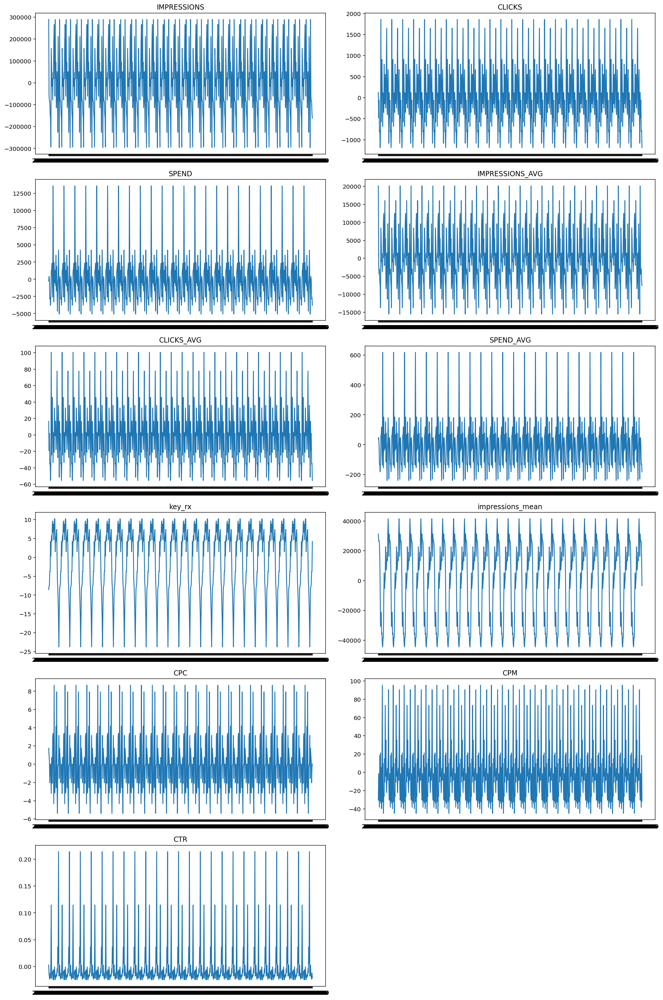

Search - Decomposition:


KeyboardInterrupt: 

In [81]:
def decompose_and_plot(dataset, column_names):

    n_cols = 2
    n_rows = (len(column_names) + n_cols - 1) // n_cols 
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, n_rows * 4))
    axes = axes.flatten()
    
    for i, column_name in enumerate(column_names):
        decomposition_result = seasonal_decompose(dataset[column_name], model='additive', period=30)
        axes[i].plot(decomposition_result.seasonal)
        axes[i].set_title(column_name)

    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)

    plt.tight_layout()
    plt.show()

columns = ['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
           'SPEND_AVG', 'redacted_rx', 'impressions_mean', 'CPC', 'CPM', 'CTR']

datasets = {
    'Social': (redacted_social, columns),
    'Search': (redacted_search, columns),
    'Digital': (redacted_digital, columns)
    #'Overall': (redacted_overall, columns)
}

for channel_name, (dataset, columns) in datasets.items():
    print(f"{channel_name} - Decomposition:")
    decompose_and_plot(dataset, columns)

In [142]:
redacted_overall.isnull().sum().sum()

0

Overall - Decomposition:


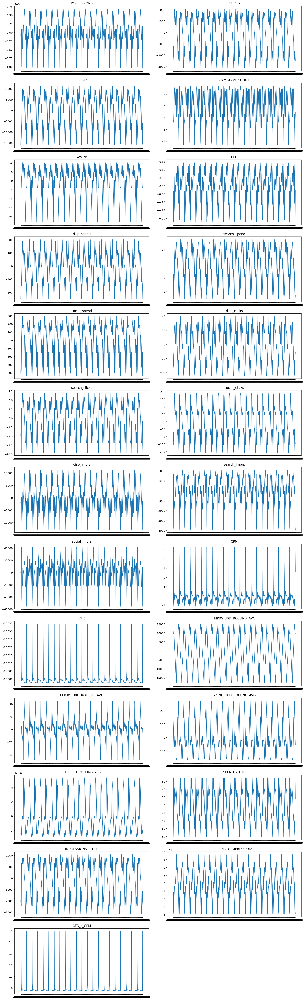

Digital - Decomposition:


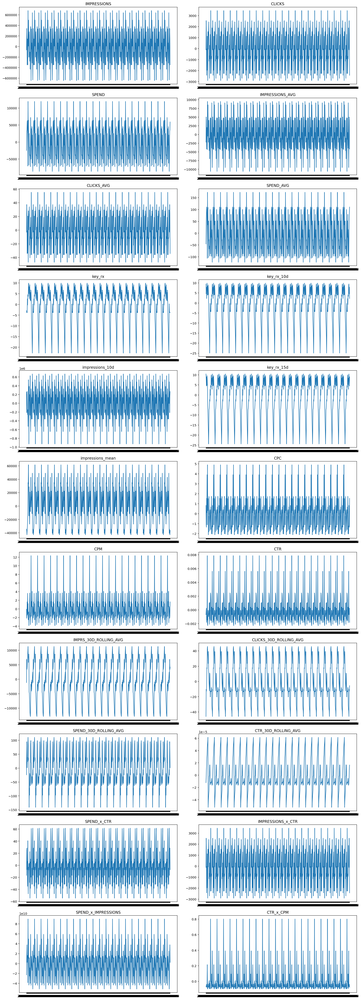

Search - Decomposition:


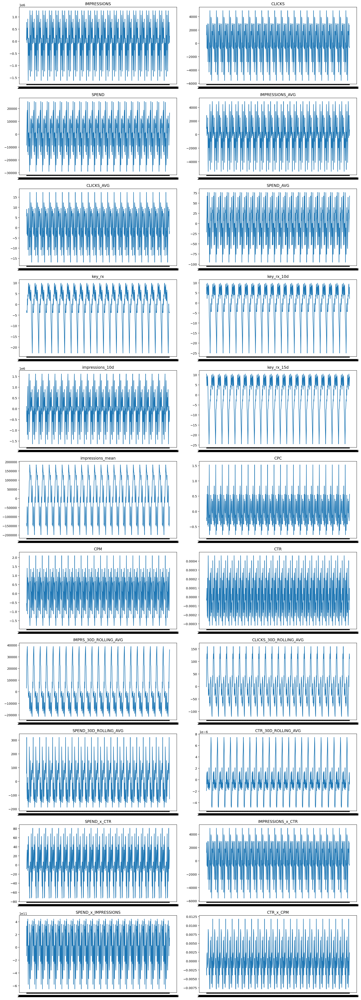

Social - Decomposition:


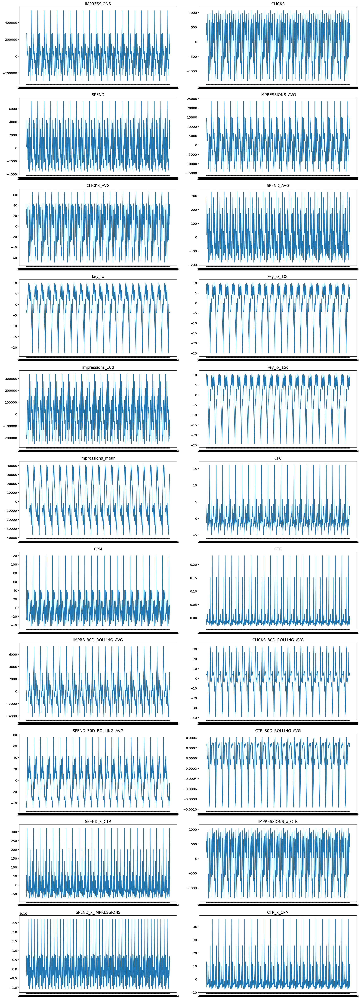

In [34]:
def decompose_and_plot(dataset, column_names):

    n_cols = 2
    n_rows = (len(column_names) + n_cols - 1) // n_cols 
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, n_rows * 4))
    axes = axes.flatten()
    
    for i, column_name in enumerate(column_names):
        decomposition_result = seasonal_decompose(dataset[column_name], model='additive', period=30)
        axes[i].plot(decomposition_result.seasonal)
        axes[i].set_title(column_name)

    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)

    plt.tight_layout()
    plt.show()

#columns = ['disp_imprs', 'social_clicks', 'search_spend', 'disp_spend', 'CTR', 'social_ctr', 'redacted_rx']

datasets = {
    'Overall': (redacted_overall_plot, redacted_overall_plot.columns),
    'Digital': (redacted_digital_plot, redacted_digital_plot.columns),
    'Search': (redacted_search_plot, redacted_search_plot.columns),
    'Social': (redacted_social_plot, redacted_social_plot.columns),
}

for channel_name, (dataset, columns) in datasets.items():
    print(f"{channel_name} - Decomposition:")
    decompose_and_plot(dataset, columns)

### Autocorrelation 

Overall - Autocorrelation:


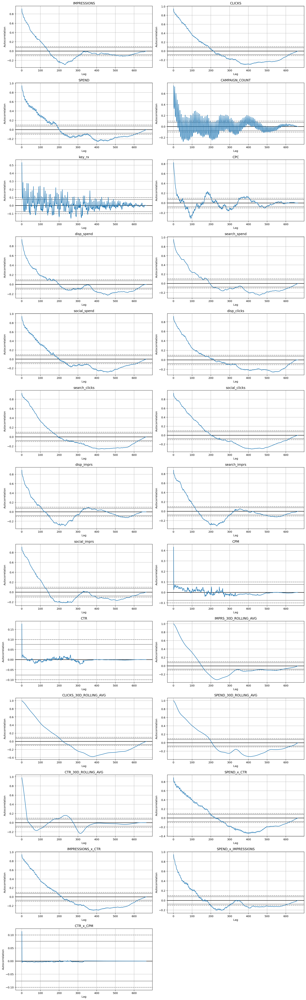



Digital - Autocorrelation:


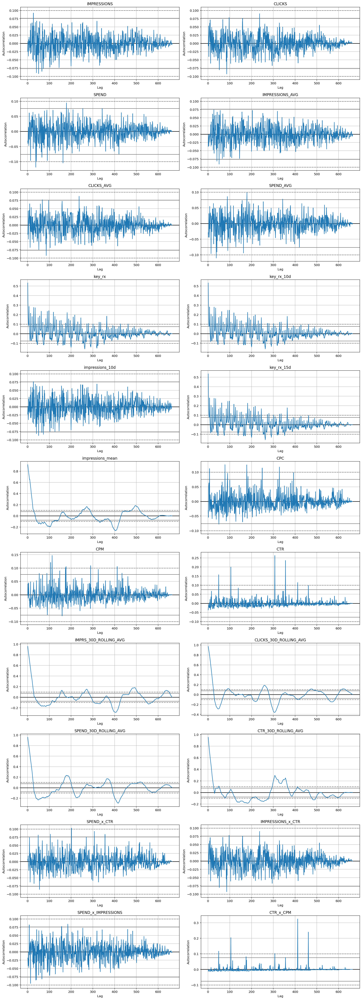



Search - Autocorrelation:


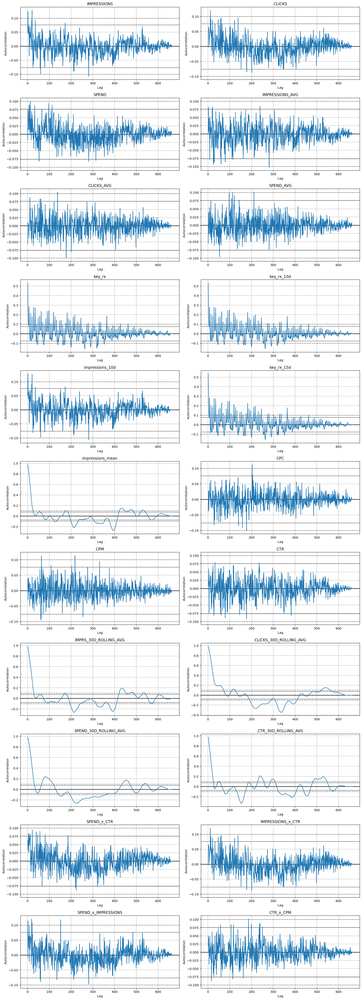



Social - Autocorrelation:


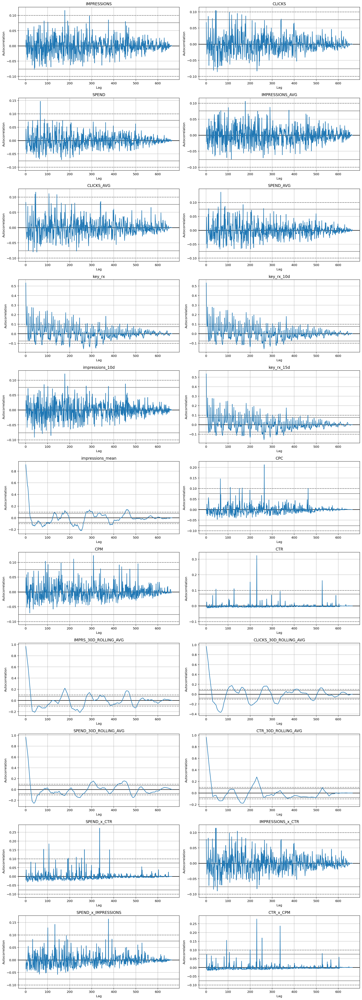

In [35]:
from pandas.plotting import autocorrelation_plot
import matplotlib.pyplot as plt

def autocorrelation_plot_grid(dataset, column_names):
    n_cols = 2
    n_rows = (len(column_names) + n_cols - 1) // n_cols 
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, n_rows * 4))
    axes = axes.flatten()

    for i, column_name in enumerate(column_names):
        ax = axes[i]
        autocorrelation_plot(dataset[column_name], ax=ax)
        ax.set_title(column_name)

    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)

    plt.tight_layout()
    plt.show()


#columns = ['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
#           'SPEND_AVG', 'redacted_rx', 'impressions_mean', 'CPC', 'CPM', 'CTR']

datasets = {
    'Overall': (redacted_overall_plot, redacted_overall_plot.columns),
    'Digital': (redacted_digital_plot, redacted_digital_plot.columns),
    'Search': (redacted_search_plot, redacted_search_plot.columns),
    'Social': (redacted_social_plot, redacted_social_plot.columns),
}

for channel_name, (dataset, columns) in datasets.items():
    print(f"{channel_name} - Autocorrelation:")
    autocorrelation_plot_grid(dataset, columns)
    print("\n")


In [40]:
redacted_overall.columns

Index(['IMPRESSIONS', 'CLICKS', 'SPEND', 'encoded_campaigns_x',
       'CAMPAIGN_COUNT_x', 'encoded_campaigns_y', 'DATA_SOURCE_SA360 Ads',
       'DATA_SOURCE_MS Bing', 'DATA_SOURCE_DCM-Prisma',
       'DATA_SOURCE_Facebook/Instagram',
       ...
       'key_rx_16d_search', 'impressions_16d_search', 'key_rx_17d_search',
       'impressions_17d_search', 'key_rx_18d_search', 'impressions_18d_search',
       'key_rx_19d_search', 'impressions_19d_search', 'key_rx_mean_search',
       'impressions_mean_search'],
      dtype='object', length=158)

In [12]:
from statsmodels.tsa.stattools import grangercausalitytests
def run_granger_tests(datasets, max_lags=30):
    for channel, dataset_info in datasets.items():
        dataset, tests = dataset_info
        print(f"{channel} - AVERAGE P-VALUES FOR 30D LAG:")
        
        for test in tests:
            column_set, label = test
            gc_results = grangercausalitytests(dataset[column_set], maxlag=max_lags, verbose=False)
            p_values = [gc_results[i+1][0]['ssr_ftest'][1] for i in range(max_lags)]
            avg_p_value = np.mean(p_values)
            print(f'{label}: {avg_p_value}')
        
        print("------------")

datasets = {
    'Social': (redacted_social, [
        (['IMPRESSIONS', 'redacted_rx_11d'], 'social- imprs/redacted_rx_11d'),
        (['IMPRESSIONS', 'redacted_rx_29d'], 'social- imprs/redacted_rx_29d'),
        (['IMPRESSIONS', 'redacted_rx'], 'social- imprs/redacted_rx'),
        (['IMPRESSIONS', 'redacted_rx_mean'], 'social- imprs/redacted_rx_mean')
    ]),
    'Search': (redacted_search, [
        (['IMPRESSIONS', 'redacted_rx_11d'], 'search- imprs/redacted_rx_11d'),
        (['IMPRESSIONS', 'redacted_rx_19d'], 'search- imprs/redacted_rx_19d'),
        (['IMPRESSIONS', 'redacted_rx'], 'search- imprs/redacted_rx'),
        (['IMPRESSIONS', 'redacted_rx_mean'], 'search- imprs/redacted_rx_mean')
    ]),
    'Digital': (redacted_digital, [
        (['IMPRESSIONS', 'redacted_rx_11d'], 'digital- imprs/redacted_rx_11d'),
        (['IMPRESSIONS', 'redacted_rx_34d'], 'digital- imprs/redacted_rx_34d'),
        (['IMPRESSIONS', 'redacted_rx'], 'digital- imprs/redacted_rx'),
        (['IMPRESSIONS', 'redacted_rx_mean'], 'digital- imprs/redacted_rx_mean')
    ]),
    'Overall': (redacted_overall, [
        (['IMPRESSIONS', 'redacted_rx_15d_display'], 'overall- imprs/redacted_rx_15d_display'),
        (['IMPRESSIONS', 'redacted_rx_15d_search'], 'overall- imprs/redacted_rx_15d_search'),
        (['CAMPAIGN_COUNT_x', 'redacted_rx'], 'overall- campaign_count/redacted_rx'),
        (['IMPRESSIONS', 'redacted_rx'], 'overall- imprs/redacted_rx'),
        (['IMPRESSIONS', 'redacted_rx_mean_search'], 'search- imprs/redacted_rx_mean'),
        (['IMPRESSIONS', 'redacted_rx_mean_social'], 'search- imprs/redacted_rx_mean'),
        (['IMPRESSIONS', 'redacted_rx_mean_display'], 'digital- imprs/redacted_rx_mean')
    ])
}

run_granger_tests(datasets, max_lags=30)

Social - AVERAGE P-VALUES FOR 30D LAG:
social- imprs/key_rx_11d: 0.6441650350740846
social- imprs/key_rx_29d: 0.8582523678556662
social- imprs/key_rx: 0.47519393876458615
social- imprs/key_rx_mean: 0.7216793925725502
------------
Search - AVERAGE P-VALUES FOR 30D LAG:
search- imprs/key_rx_11d: 0.09671416709607492
search- imprs/key_rx_19d: 0.08038422125297248
search- imprs/key_rx: 0.24590759033212964
search- imprs/key_rx_mean: 0.4088611231775
------------
Digital - AVERAGE P-VALUES FOR 30D LAG:
digital- imprs/key_rx_11d: 0.6246850024594085
digital- imprs/key_rx_34d: 0.7580606887250262
digital- imprs/key_rx: 0.24923761579756304
digital- imprs/key_rx_mean: 0.4559176955361068
------------
Overall - AVERAGE P-VALUES FOR 30D LAG:
overall- imprs/key_rx_15d_display: 0.033015032299185364
overall- imprs/key_rx_15d_search: 0.033015032299185364
overall- campaign_count/key_rx: 0.007668124906642976
overall- imprs/key_rx: 0.019771681803661276
search- imprs/key_rx_mean: 0.0746652389555703
search- impr

### Correlation Matrix/Heatmap



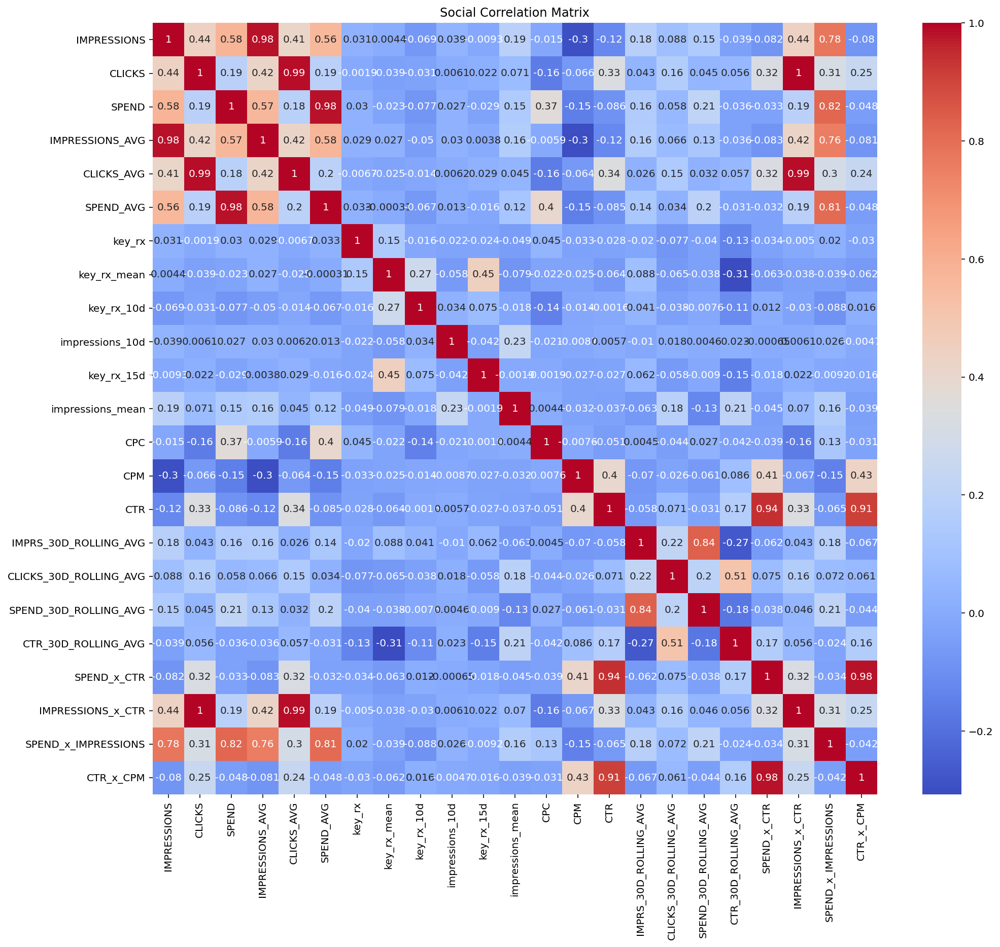

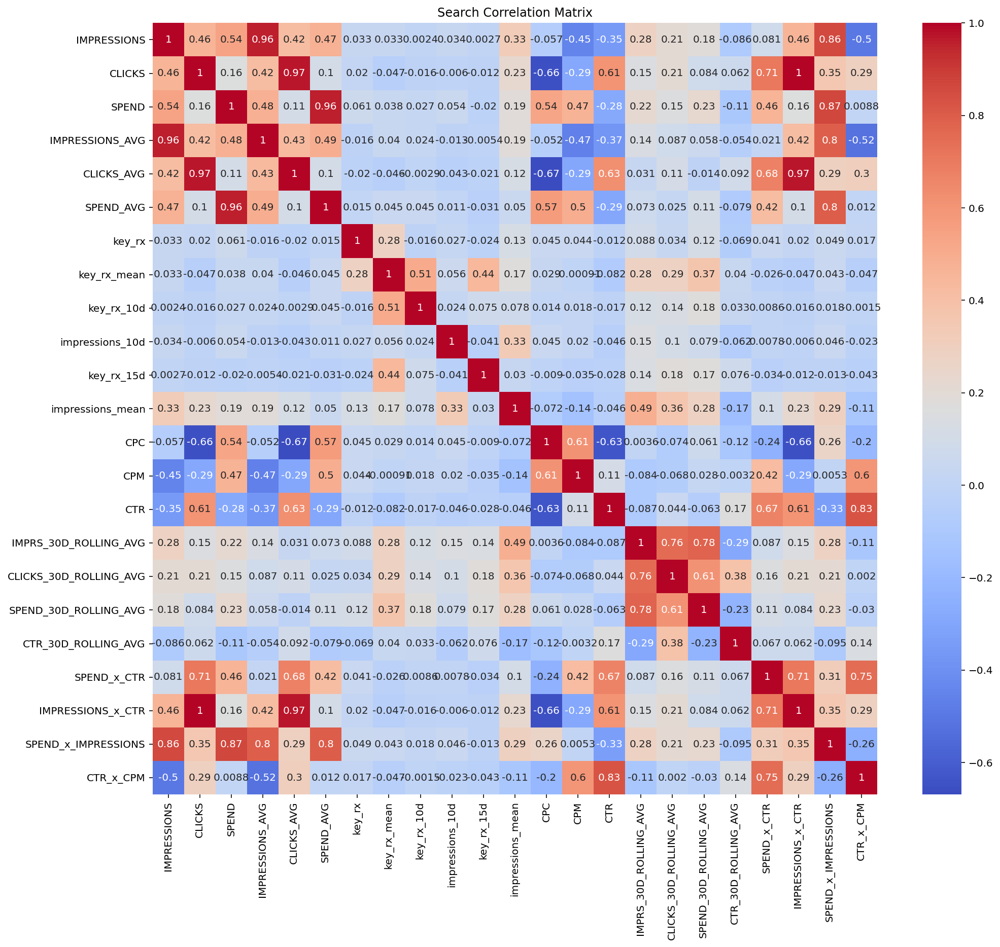

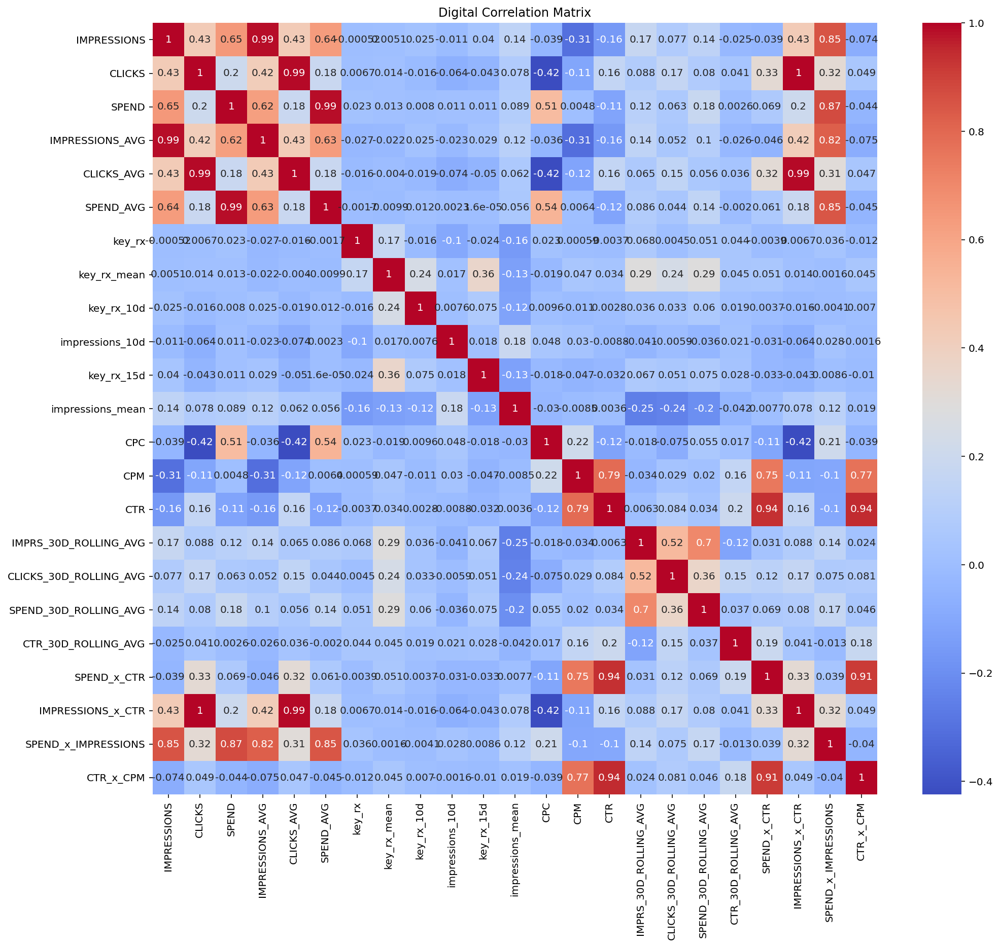

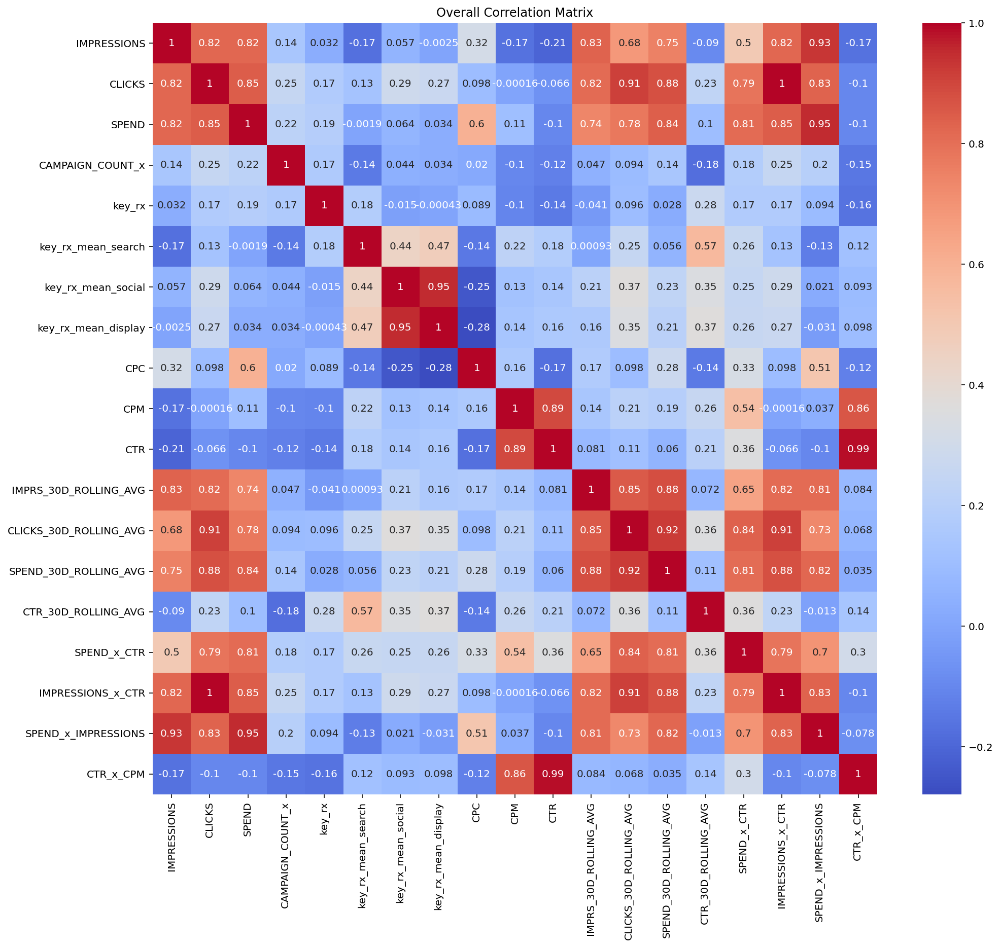

In [13]:
# Social
#columns_social = ['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG', 'SPEND_AVG', 'redacted_rx', 'impressions_mean', 'CPC', 'CPM', 'CTR', 'redacted_rx_10d', 'redacted_rx_15d']

plt.figure(figsize=(16, 14))
sns.heatmap(redacted_social_plot.corr(), annot=True, cmap='coolwarm')
plt.title('Social Correlation Matrix')
plt.show()

# Search
#columns_search = ['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG','SPEND_AVG', 'redacted_rx', 'impressions_mean', 'CPC', 'CPM', 'CTR', 'redacted_rx_10d', 'redacted_rx_15d']

plt.figure(figsize=(16, 14))
sns.heatmap(redacted_search_plot.corr(), annot=True, cmap='coolwarm')
plt.title('Search Correlation Matrix')
plt.show()

# Display
#columns_digital = ['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG','SPEND_AVG', 'redacted_rx', 'impressions_mean', 'CPC', 'CPM', 'CTR', 'redacted_rx_10d', 'redacted_rx_15d']

plt.figure(figsize=(16, 14))
sns.heatmap(redacted_digital_plot.corr(), annot=True, cmap='coolwarm')
plt.title('Digital Correlation Matrix')
plt.show()

# Overall
#columns_overall =  ['disp_imprs', 'social_clicks', 'search_spend', 'disp_spend', 'CTR', 'social_ctr', 'redacted_rx']

plt.figure(figsize=(16, 14))
sns.heatmap(redacted_overall_plot.corr(), annot=True, cmap='coolwarm')
plt.title('Overall Correlation Matrix')
plt.show()

### Joint Plots

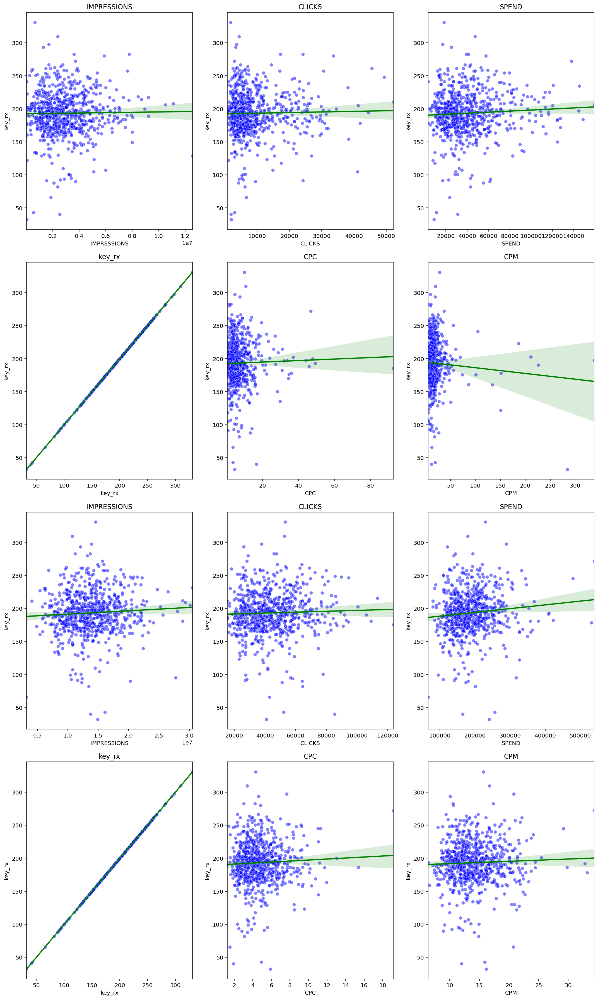

In [94]:
# Joint plots for linear correlation to target and column distribution

columns = ['IMPRESSIONS', 'CLICKS', 'SPEND', 'redacted_rx', 'CPC', 'CPM', 'CTR']

datasets = [redacted_digital[columns], redacted_search[columns], redacted_social[columns], redacted_overall[['IMPRESSIONS', 'CLICKS', 'SPEND', 'redacted_rx', 'CPC', 'CPM', 'CTR', 'CAMPAIGN_COUNT']]]

nrows, ncols = 4, 3
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, 25))

axes_flat = axes.flatten()
position = 0

for dataset in datasets:
    for column in dataset.columns[:-1]: 
        if position < len(axes_flat):
            ax = axes_flat[position]
            sns.scatterplot(x=column, y='redacted_rx', data=dataset, ax=ax, color='blue', alpha=0.5)
            sns.regplot(x=column, y='redacted_rx', data=dataset, ax=ax, scatter=False, color='green')
            ax.set_title(column)
            position += 1

plt.tight_layout()
plt.show()

### Line Plots (Monthly Resamples) 

In [128]:
digital_dataset.columns

Index(['IMPRESSIONS_SUM', 'CLICKS_SUM', 'SPEND_SUM', 'IMPRESSIONS_AVG',
       'CLICKS_AVG', 'SPEND_AVG', 'key_rx', 'key_rx_cume', 'key_rx_10d',
       'impressions_sum_10d', 'key_rx_11d', 'impressions_sum_11d',
       'key_rx_12d', 'impressions_sum_12d', 'key_rx_13d',
       'impressions_sum_13d', 'key_rx_14d', 'impressions_sum_14d',
       'key_rx_15d', 'impressions_sum_15d', 'key_rx_16d',
       'impressions_sum_16d', 'key_rx_17d', 'impressions_sum_17d',
       'key_rx_18d', 'impressions_sum_18d', 'key_rx_19d',
       'impressions_sum_19d', 'key_rx_20d', 'impressions_sum_20d',
       'key_rx_21d', 'impressions_sum_21d', 'key_rx_22d',
       'impressions_sum_22d', 'key_rx_23d', 'impressions_sum_23d',
       'key_rx_24d', 'impressions_sum_24d', 'key_rx_25d',
       'impressions_sum_25d', 'key_rx_26d', 'impressions_sum_26d',
       'key_rx_27d', 'impressions_sum_27d', 'key_rx_28d',
       'impressions_sum_28d', 'key_rx_29d', 'impressions_sum_29d',
       'key_rx_30d', 'impressions_sum_

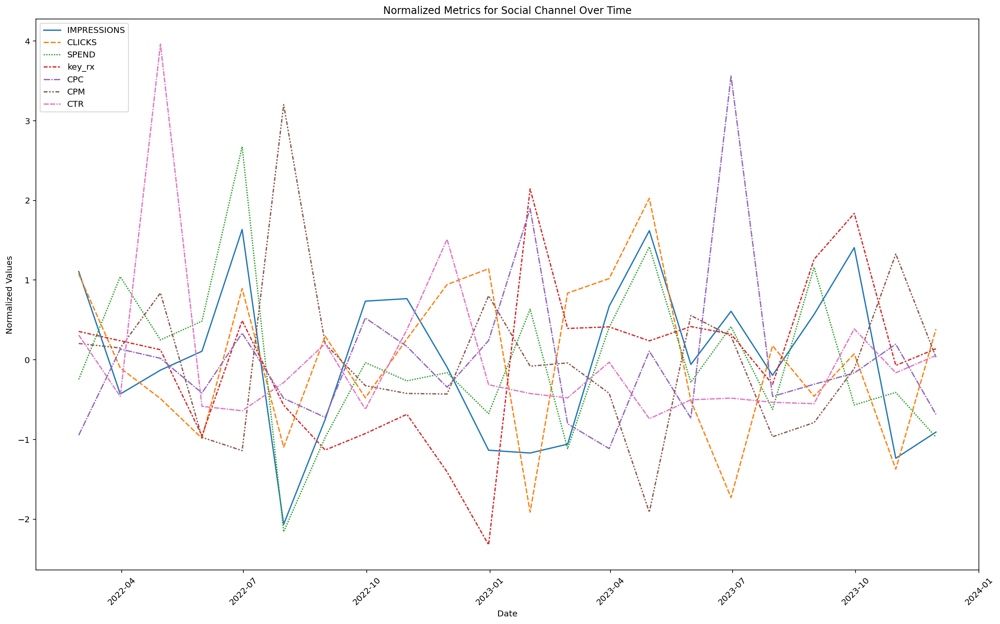

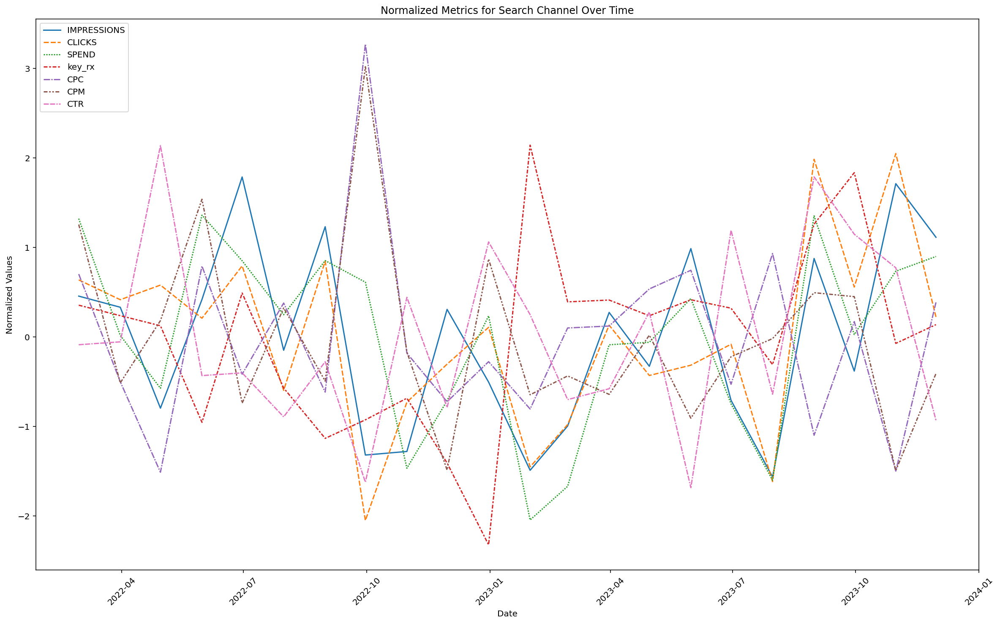

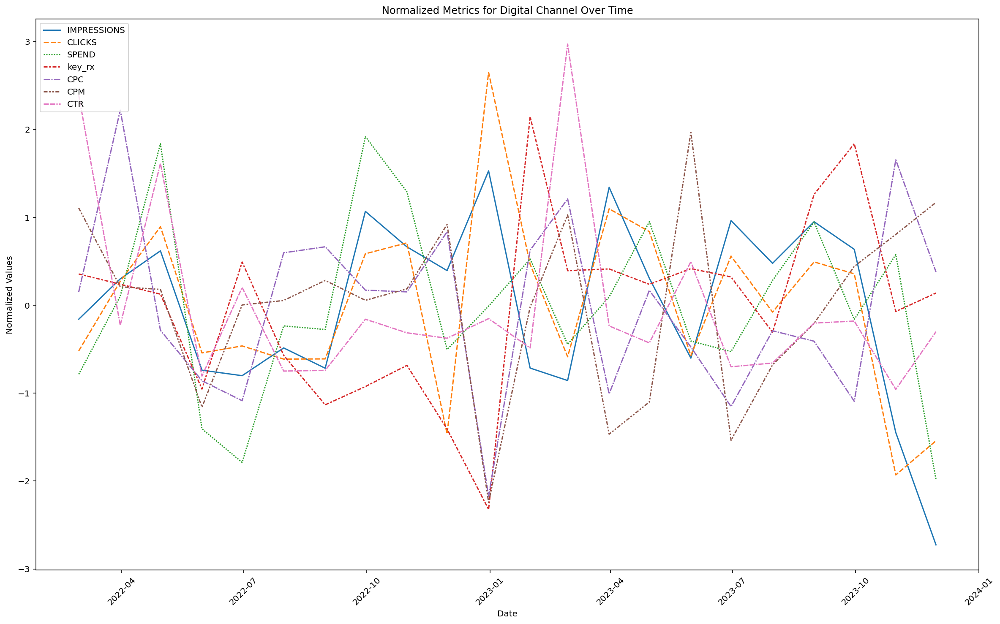

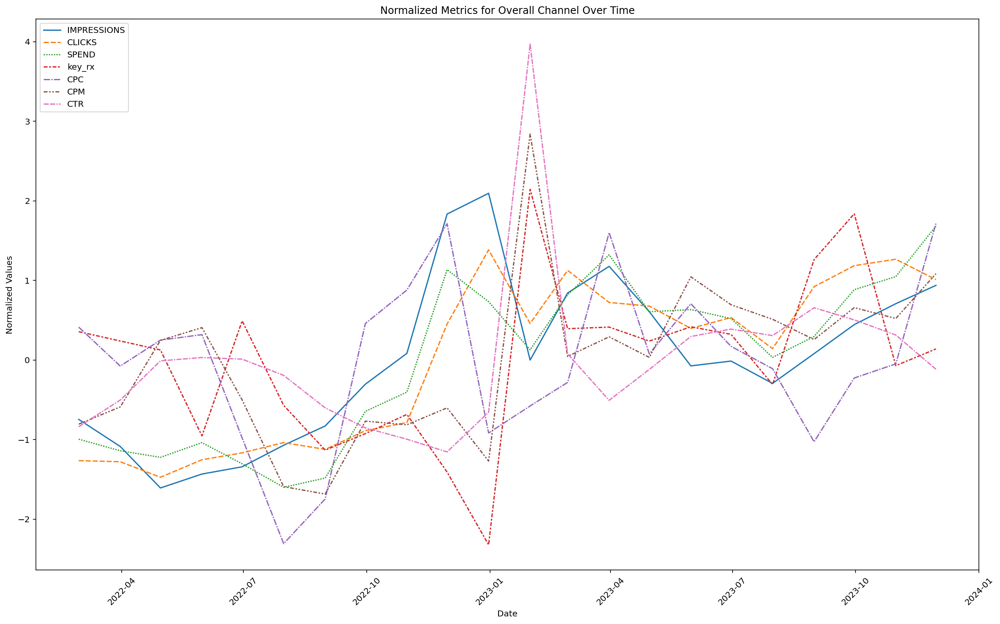

In [43]:
from sklearn.preprocessing import StandardScaler

columns = ['IMPRESSIONS', 'CLICKS', 'SPEND', 'redacted_rx', 'CPC', 'CPM', 'CTR']

datasets = {
    'Social': redacted_social_plot,
    'Search': redacted_search_plot,
    'Digital': redacted_digital_plot,
    'Overall': redacted_overall_plot
}

# Normalize scale
scaler = StandardScaler()

for channel, df in datasets.items():
    # Resample 
    df.index = pd.to_datetime(df.index)
    df_monthly_mean = df[columns].resample('M').mean()

    df_scaled = pd.DataFrame(scaler.fit_transform(df_monthly_mean), columns=df_monthly_mean.columns, index=df_monthly_mean.index)
    plt.figure(figsize=(20, 12))
    sns.lineplot(data=df_scaled)
    
    plt.title(f'Normalized Metrics for {channel} Channel Over Time')
    plt.ylabel('Normalized Values')
    plt.xlabel('Date')
    plt.xticks(rotation=45)  
    plt.legend(df_scaled.columns, loc='upper left')
    plt.show()

## Modeling

- **Preprocessing Function:** Prepares data for modeling by selecting features, splitting into training and testing sets, and optionally scaling.
- **ModelWithSHAP Class:** Wraps model pipelines to include SHAP values and feature importance, allowing for model interpretation.
- **Cross-validation Function:** Evaluates model performance using cross-validation, providing a mean and standard deviation of the scoring metric.
- **Modeling Pipeline Function:** Compiles modeling process, including scaling, model selection, hyperparameter tuning with GridSearchCV, and evaluation. Outputs include best model based on R2 score, prediction results, and evaluation metrics.
- **SHAP Modeling:** Generates SHAP values and plots for model explanation, provides impact of each feature on the model's predictions.
- **Best Model Selection Across Targets:** Compares models across different prediction targets, selecting the best performing model based on R2 score.
- **Visualization Functions:** Include plotting actual vs. predicted values and other metrics for model evaluation and comparison.

 **Models**
    - OLS (Ordinary Least Squares): linear regression, linear relationship, no regularization
    - Lasso: model feature selection, sparse (L1 Regularization, shrinks coefficients to zero)
    - Ridge: good against multicolinearity (L2 regularization, shrinks coefficients but not to zero)
    - RFR (Random Forest Regressor): ensemble combines decision trees, good for overfitting
    - Decision Tree
    - SVM (Support Vector Machine): good for non-linear data, finds best margin separating data points
    - GBR (Gradient Boosting Regressor): boosting method builds trees sequentially, each tree corrects errors of previous trees
    - HistGBR (Histogram Gradient Boosting Regressor): same thing as GBR using histograms, good if using categorical features
    
**Notes:**
- Base model evaluation on metric like MAPE instead of R2?
- Include time-series forecast
- Include other forms of model interpretation (LIME etc.)
- Need to add residuals 
- move to classifier?
- Need to see how actual data performs/can be evaluated


In [34]:
# Preproces dataset function (split X_train, y_train, x_test, y_test and scale)
## Arguments: datset, target1, target2, target3, scale (optional)
def preprocess_train(dataset, target, target_list, other_targets_to_drop):

    #columns_to_drop = ['redacted_rx','redacted_rx_mean']
    columns_to_drop = target_list
    X = dataset.drop(labels=columns_to_drop, axis=1)
    X = X.drop(labels=[target], axis=1, errors='ignore')
    #X = dataset.drop(labels=columns_to_drop, axis=1)
    #X = dataset
    #X = X.drop(labels=[target], axis=1, errors='ignore')
    #print(X.columns)
    y = dataset[target]

    tss = TimeSeriesSplit(n_splits=3)
    for train_index, test_index in tss.split(X):
        X_train, X_test = X.iloc[train_index, :], X.iloc[test_index, :]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    #y_train = y_train.values.reshape(-1, 1)
    #y_test = y_test.values.reshape(-1, 1)

    #if scale_data:
    #    ss = StandardScaler()
    #    X_train = ss.fit_transform(X_train)
    #    X_test = ss.transform(X_test)
    #    y_train = ss.fit_transform(y_train)
    #    y_test = ss.transform(y_test)

    return X_train, y_train, X_test, y_test


from sklearn.base import BaseEstimator, TransformerMixin

class ModelWithSHAP:
    def __init__(self, model_pipeline, model_name, feature_names=None):
        self.model_pipeline = model_pipeline
        self.model_name = model_name
        self.feature_names = feature_names 
        
        # Check if the pipeline has only one step (if only an estimator, no preprocessing)
        if len(model_pipeline.steps) == 1:
            self.preprocessor = model_pipeline
            self.final_estimator = model_pipeline.steps[0][1]
        else:
            self.preprocessor = Pipeline(model_pipeline.steps[:-1])  # preprocessing steps
            self.final_estimator = model_pipeline.steps[-1][1]  # estimator
       
        self.explainer = None
        self.shap_values = None
        self.X_transformed = None

    def fit(self, X, y, **fit_params):
        self.model_pipeline.fit(X, y)
        return self

    def predict(self, X, **predict_params):
        return self.model_pipeline.predict(X)

    def generate_shap(self, X, feature_names=None, background_sample_size=100):
        if feature_names is not None:
            self.feature_names = feature_names
        else:
            self.feature_names = X.columns.tolist() if hasattr(X, 'columns') else [f"Feature {i}" for i in range(X.shape[1])]

        self.X_transformed = self.preprocessor.transform(X) if hasattr(self.preprocessor, 'transform') else X
        background_data = shap.sample(self.X_transformed, background_sample_size)

        if isinstance(self.final_estimator, (RandomForestRegressor, GradientBoostingRegressor, DecisionTreeRegressor)):
            self.explainer = shap.TreeExplainer(self.final_estimator, model_output="raw")
        else:
            self.explainer = shap.KernelExplainer(self.final_estimator.predict, background_data)
            
        if hasattr(self.explainer, 'shap_values'):
            try:
                self.shap_values = self.explainer.shap_values(self.X_transformed, check_additivity=False)
            except TypeError:
                self.shap_values = self.explainer.shap_values(self.X_transformed)
        else:
            self.shap_values = self.explainer.shap_values(self.X_transformed)
            
        return self.shap_values

    def plot_shap_summary(self, plot_type="bar"):
        if self.shap_values is not None and self.feature_names is not None:
            shap.summary_plot(self.shap_values, features=self.X_transformed, feature_names=self.feature_names, plot_type=plot_type)
        else:
            print("SHAP values or feature names have not been generated yet. Call generate_shap first.")

    def plot_shap_summary2(self, shap_values, plot_type="bar"):
        plt.figure()
        shap.summary_plot(shap_values, features=self.X_transformed, feature_names=self.feature_names, plot_type=plot_type)
        fig = plt.gcf()  
        plt.close(fig) 
        return fig

# Cross-validation function
## Arguments: model, X set, y set, scoring metric
def perform_cv(model, X, y, scoring='r2'):
    scores = cross_val_score(model, X, y, cv=5, scoring=scoring)
    return {'mean_score': np.mean(scores), 'std_score': np.std(scores)}


# Modeling Pipeline Function
# Arguments: X_train, y_train, X_test, y_test, scaling (optional)
def model(X_train, y_train, X_test, y_test, ss=None, y_scaler=None):
   
    if ss is None:
        ss = StandardScaler()
    if y_scaler is None:
        y_scaler = StandardScaler()
        

    models_requiring_scaling = {
        'OLS', 'Lasso', 'Ridge', 'SVM', 'GBR', 'HistGBR'
    }

    models = {
        'OLS': {
            'pipeline':
            Pipeline([
                #('poly', PolynomialFeatures()),
                ('fit', linear_model.LinearRegression())
            ]),
            'requires_scaling':
            True
        },
        'Lasso': {
            'pipeline':
            Pipeline([
                #('poly', PolynomialFeatures()),
                ('fit', linear_model.Lasso())
            ]),
            'requires_scaling':
            True
        },
        'Ridge': {
            'pipeline':
            Pipeline([
                #('poly', PolynomialFeatures()),
                ('fit', linear_model.Ridge())
            ]),
            'requires_scaling':
            True
        },
        'RFR': {
            'pipeline': Pipeline([('fit', RandomForestRegressor())]),
            'requires_scaling': True
        },
        #'DecisionTree': {
        #    'pipeline': Pipeline([('fit', DecisionTreeRegressor())]),
        #    'requires_scaling': True
        #},
        'SVM': {
            'pipeline': Pipeline([('fit', svm.SVR())]),
            'requires_scaling': True
        },
        #'GBR': {
        #    'pipeline': Pipeline([('fit', GradientBoostingRegressor())]),
        #    'requires_scaling': True
        #},
        #'HistGBR': {
        #    'pipeline': Pipeline([('fit', HistGradientBoostingRegressor())]),
        #    'requires_scaling': True
        #}
    }

    param_grids = {
        'Lasso': {
            'fit__alpha': [0.005, 0.02, 0.03, 0.05, 0.06]
        },
        'Ridge': {
            'fit__alpha': [550, 580, 600, 620, 650]
        },
        'RFR': {
            "fit__n_estimators": [100, 200, 300, 400, 500]
        },
        'DecisionTree': {
            "fit__max_depth": [10, 20, 30, None],
            "fit__min_samples_split": [2, 5, 10],
            "fit__min_samples_leaf": [1, 2, 4]
        },
        'SVM': {
            "fit__C": [0.1, 1, 10],
            "fit__gamma": ['scale', 'auto'],
            "fit__epsilon": [0.01, 0.1, 0.2]
        },
        'GBR': {
            "fit__n_estimators": [100, 200, 300],
            "fit__learning_rate": [0.01, 0.1, 0.2],
            "fit__max_depth": [3, 4, 5]
        },
        'HistGBR': {}
    }

    best_estimators = {}
    cv_results = {}
    predictions = {}
    evaluation_metrics = {}
    model_shap_values = {}
    model_shap_plots = {}
    r2_scores = {}

    for name, model_info in models.items():
        print("\n")
        print(f"Processing {name} model...")
        pipeline = model_info['pipeline']
        requires_scaling = model_info['requires_scaling']

        # Scale 
        X_train_processed, X_test_processed = X_train, X_test
        y_train_processed, y_test_processed = y_train, y_test
        if requires_scaling:
            X_train_processed = ss.fit_transform(X_train)
            X_test_processed = ss.transform(X_test)
            y_train_processed = y_scaler.fit_transform(y_train.values.reshape(-1, 1))
            y_test_processed = y_scaler.transform(y_test.values.reshape(-1, 1))

        # GridSearch
        if name in param_grids:
            grid_search = GridSearchCV(
                estimator=pipeline,
                param_grid=param_grids[name],
                cv=5,
                scoring='r2',
                refit=True,
                verbose=1
            )
            grid_search.fit(X_train_processed, y_train_processed.ravel())
            best_model = grid_search.best_estimator_
            best_estimators[name] = best_model
            cv_results[name] = {
                'best_score': grid_search.best_score_,
                'best_params': grid_search.best_params_
            }
        else:
            model_info['pipeline'].fit(X_train_processed, y_train_processed.ravel())
            best_model = pipeline
            best_estimators[name] = best_model
            cv_results[name] = {'best_score': 'N/A', 'best_params': 'Default'}

        # ModelWithSHAP - get feature importance
        model_with_shap = ModelWithSHAP(model_pipeline=best_model, model_name=name)
        #model_with_shap.fit(X_train_processed, y_train_processed) 
        y_pred_processed = model_with_shap.predict(X_test_processed)
        feature_names = X_test.columns.tolist()
        #print(feature_names)
        shap_values = model_with_shap.generate_shap(X_test_processed, feature_names=feature_names, background_sample_size=20)  # Generate SHAP explanations
        print("\n")
        print(f"Shap Feature Impact on model {name}: ")
        shap_plot = model_with_shap.plot_shap_summary2(shap_values)
        shap_plot.show()
        
        model_shap_values[name] = shap_values
        model_shap_plots[name] = shap_plot
        
        # Scale values back to original
        if requires_scaling:
            y_pred_original_scale = y_scaler.inverse_transform(y_pred_processed.reshape(-1, 1)).flatten()
            y_test_original_scale = y_scaler.inverse_transform(y_test_processed).flatten()
        else:
            y_pred_original_scale = y_pred_processed
            y_test_original_scale = y_test_processed
        
        r2_score_value = r2_score(y_test_original_scale, y_pred_original_scale)
        mape_value = mean_absolute_percentage_error(y_test_original_scale, y_pred_original_scale)
        mse_value = mean_squared_error(y_test_original_scale, y_pred_original_scale)
        print("\n")
        print(f"{name} R2: ", r2_score_value)
        print(f"{name} MAPE: ", mape_value)
        print(f"{name} MSE: ", mse_value)
        print("\n")
        r2_scores[name] = r2_score_value
        
        plot_preds(y_test_original_scale, y_pred_original_scale)
        
        # Evaluation metrics
        evaluation_metrics[name] = {
            'MAE': mean_absolute_error(y_test_original_scale, y_pred_original_scale),
            'MSE': mean_squared_error(y_test_original_scale, y_pred_original_scale),
            'RMSE': np.sqrt(mean_squared_error(y_test_original_scale, y_pred_original_scale)),
            'R2': r2_score(y_test_original_scale, y_pred_original_scale),
            'MAPE': mean_absolute_percentage_error(y_test_original_scale, y_pred_original_scale)
        }

        predictions[name] = y_pred_original_scale
    
    predictions['Actuals'] = y_test_original_scale
    
    #for name, model in best_estimators.items():
    #    print(name, model)
    #    model_with_shap = ModelWithSHAP(model_pipeline=model, model_name=name)
    #    y_pred = model_with_shap.predict(X_test)
    #    r2_score = metrics.r2_score(y_test, y_pred)
    #    r2_scores[name] = r2_score
    
    # Return the best model based on R2 score
    best_model_name = max(r2_scores, redacted=r2_scores.get)
    best_model = best_estimators[best_model_name]
    print(best_model)
    print("\n")
    
    results = {
        'best_model_name': best_model_name,
        'best_model': best_model,
        'best_estimators': best_estimators,
        'cv_results': cv_results,
        'predictions': predictions,
        'evaluation_metrics': evaluation_metrics,
        'model_shap_values': model_shap_values,
        'model_shap_plots': model_shap_plots,
        'r2_scores': r2_scores 
    }
    
    return results

def find_best_model_across_targets(dataset, targets):
    overall_best_model = None
    overall_best_r2 = -float('inf')
    overall_best_model_name = ""
    target_list = targets
    for target in targets:
        print(f"Running modeling process for target: {target}\n")
        
        other_targets_to_drop = [t for t in targets if t != target]
        X_train, y_train, X_test, y_test = preprocess_train(dataset, target, target_list, other_targets_to_drop)
        results = model(X_train, y_train, X_test, y_test, ss=None, y_scaler=None)
        
        best_model_name = results['best_model_name']
        target_best_r2 = results['evaluation_metrics'][best_model_name]['R2']
        print(f"Best model for {target} is {best_model_name} with R2 score: {target_best_r2}\n")
        
        if target_best_r2 > overall_best_r2:
            overall_best_r2 = target_best_r2
            overall_best_model = results['best_model']
            overall_best_model_name = best_model_name
            overall_best_model_preds = results['predictions']
            overall_best_model_metrics = results['evaluation_metrics']
            overall_best_model_shaps = results['model_shap_values']
            overall_best_model_shap_plt = results['model_shap_plots']
    
    best_model_results = {
        'best_model': overall_best_model,
        'best_model_name': overall_best_model_name,
        'overall_best_r2': overall_best_r2,
        'predictions': overall_best_model_preds,
        'evaluation_metrics': overall_best_model_metrics,
        'model_shap_values': overall_best_model_shaps,
        'model_shap_plots': overall_best_model_shap_plt,
    }
    
    #print(f"Overall best model across targets is {overall_best_model_name} with R2 score: {overall_best_r2}\n")

    return best_model_results

# Plot actuals vs predictions function
## Arguments: y_test, y_preds (predictions output)
def plot_preds(y_test, y_pred):
    # Scatter plot
    plt.figure(figsize=(10, 10))
    plt.scatter(y_test, y_pred)
    plt.plot([y_test.min(), y_test.max()],
             [y_test.min(), y_test.max()],
             'k--',
             lw=4)
    plt.title('Model Prediction vs Actual')
    plt.xlabel('Actual Values')
    plt.ylabel('Predicted Values')
    plt.show()

    # Line plot
    plt.figure(figsize=(15, 10))
    plt.plot(y_test, label="Actual")
    plt.plot(y_pred, label="Predicted")
    plt.legend()
    plt.title("Actual vs Predicted")
    plt.show()


# Model evaluation function
## Arguments: model, X train/test, y train/test
def evaluate_model(model, X_train, y_train, X_test, y_test):
    model.fit(X_train, y_train.ravel())
    y_pred = model.predict(X_test)
    mae = metrics.mean_absolute_error(y_test, y_pred)
    mse = metrics.mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mape = metrics.mean_absolute_percentage_error(y_test, y_pred)

    print(f"MAE: {mae}, MSE: {mse}, RMSE: {rmse}, MAPE: {mape}%")
    plot_preds(y_test, y_pred)

### Run Model Pipeline and Evaluate

#### TEST 1 (ONLY LAGS) [FIRST INSTANCE]

In [22]:
redacted_digital.columns

Index(['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
       'SPEND_AVG', 'key_rx', 'key_rx_10d', 'impressions_10d', 'key_rx_11d',
       'impressions_11d', 'key_rx_12d', 'impressions_12d', 'key_rx_13d',
       'impressions_13d', 'key_rx_14d', 'impressions_14d', 'key_rx_15d',
       'impressions_15d', 'key_rx_16d', 'impressions_16d', 'key_rx_17d',
       'impressions_17d', 'key_rx_18d', 'impressions_18d', 'key_rx_19d',
       'impressions_19d', 'key_rx_20d', 'impressions_20d', 'key_rx_21d',
       'impressions_21d', 'key_rx_22d', 'impressions_22d', 'key_rx_23d',
       'impressions_23d', 'key_rx_24d', 'impressions_24d', 'key_rx_25d',
       'impressions_25d', 'key_rx_26d', 'impressions_26d', 'key_rx_27d',
       'impressions_27d', 'key_rx_28d', 'impressions_28d', 'key_rx_29d',
       'impressions_29d', 'key_rx_30d', 'impressions_30d', 'key_rx_31d',
       'impressions_31d', 'key_rx_32d', 'impressions_32d', 'key_rx_33d',
       'impressions_33d', 'key_rx_34d', 'impre

In [16]:

import re

def drop_columns_by_pattern(df, patterns):

    combined_pattern = '|'.join(patterns)
    columns_to_drop = [col for col in df.columns if re.search(combined_pattern, col)]
    df_dropped = df.drop(columns=columns_to_drop)

    return df_dropped


In [17]:
pattern_drop_lags = [r'impressions_\d+d', r'redacted_rx_\d+d']

redacted_digital_nolags = drop_columns_by_pattern(redacted_digital, pattern_drop_lags)
redacted_search_nolags = drop_columns_by_pattern(redacted_search, pattern_drop_lags)
redacted_social_nolags = drop_columns_by_pattern(redacted_social, pattern_drop_lags)
redacted_overall_nolags = drop_columns_by_pattern(redacted_overall, pattern_drop_lags)

redacted_digital_nolags.columns

Index(['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
       'SPEND_AVG', 'key_rx', 'key_rx_mean', 'impressions_mean', 'CPC', 'CPM',
       'CTR', 'IMPRS_30D_ROLLING_AVG', 'CLICKS_30D_ROLLING_AVG',
       'SPEND_30D_ROLLING_AVG', 'CTR_30D_ROLLING_AVG', 'SPEND_x_CTR',
       'IMPRESSIONS_x_CTR', 'SPEND_x_IMPRESSIONS', 'CTR_x_CPM'],
      dtype='object')

In [23]:
redacted_social_nolags.columns

Index(['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
       'SPEND_AVG', 'key_rx', 'key_rx_mean', 'impressions_mean', 'CPC', 'CPM',
       'CTR', 'IMPRS_30D_ROLLING_AVG', 'CLICKS_30D_ROLLING_AVG',
       'SPEND_30D_ROLLING_AVG', 'CTR_30D_ROLLING_AVG', 'SPEND_x_CTR',
       'IMPRESSIONS_x_CTR', 'SPEND_x_IMPRESSIONS', 'CTR_x_CPM'],
      dtype='object')

In [24]:
redacted_digital_lagsonly = redacted_digital[[
    'IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
    'SPEND_AVG', 'redacted_rx', 'redacted_rx_mean', 'redacted_rx_10d', 'impressions_10d', 'redacted_rx_11d',
    'impressions_11d', 'redacted_rx_12d', 'impressions_12d', 'redacted_rx_13d',
    'impressions_13d', 'redacted_rx_14d', 'impressions_14d', 'redacted_rx_15d',
    'impressions_15d', 'redacted_rx_16d', 'impressions_16d', 'redacted_rx_17d',
    'impressions_17d', 'redacted_rx_18d', 'impressions_18d', 'redacted_rx_19d',
    'impressions_19d', 'redacted_rx_20d', 'impressions_20d', 'redacted_rx_21d',
    'impressions_21d', 'redacted_rx_22d', 'impressions_22d', 'redacted_rx_23d',
    'impressions_23d', 'redacted_rx_24d', 'impressions_24d', 'redacted_rx_25d',
    'impressions_25d', 'redacted_rx_26d', 'impressions_26d', 'redacted_rx_27d',
    'impressions_27d', 'redacted_rx_28d', 'impressions_28d', 'redacted_rx_29d',
    'impressions_29d', 'redacted_rx_30d', 'impressions_30d', 'redacted_rx_31d',
    'impressions_31d', 'redacted_rx_32d', 'impressions_32d', 'redacted_rx_33d',
    'impressions_33d', 'redacted_rx_34d', 'impressions_34d', 'impressions_mean'
]]

redacted_digital_lagsonly_min = redacted_digital[[
    'IMPRESSIONS', 'CLICKS', 'SPEND', 'redacted_rx', 'redacted_rx_10d', 'redacted_rx_mean',
    'impressions_10d', 'redacted_rx_11d', 'impressions_11d', 'redacted_rx_12d',
    'impressions_12d', 'redacted_rx_13d', 'impressions_13d', 'redacted_rx_14d',
    'impressions_14d', 'redacted_rx_15d', 'impressions_15d', 'redacted_rx_16d',
    'impressions_16d', 'redacted_rx_17d', 'impressions_17d', 'redacted_rx_18d',
    'impressions_18d', 'redacted_rx_19d', 'impressions_19d', 'redacted_rx_20d',
    'impressions_20d', 'redacted_rx_21d', 'impressions_21d', 'redacted_rx_22d',
    'impressions_22d', 'redacted_rx_23d', 'impressions_23d', 'redacted_rx_24d',
    'impressions_24d', 'redacted_rx_25d', 'impressions_25d', 'redacted_rx_26d',
    'impressions_26d', 'redacted_rx_27d', 'impressions_27d', 'redacted_rx_28d',
    'impressions_28d', 'redacted_rx_29d', 'impressions_29d', 'redacted_rx_30d',
    'impressions_30d', 'redacted_rx_31d', 'impressions_31d', 'redacted_rx_32d',
    'impressions_32d', 'redacted_rx_33d', 'impressions_33d', 'redacted_rx_34d',
    'impressions_34d'
]]

redacted_search_lagsonly = redacted_search[[
    'IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
    'SPEND_AVG', 'redacted_rx', 'redacted_rx_1d', 'redacted_rx_mean', 'impressions_1d', 'redacted_rx_2d',
    'impressions_2d', 'redacted_rx_3d', 'impressions_3d', 'redacted_rx_4d',
    'impressions_4d', 'redacted_rx_5d', 'impressions_5d', 'redacted_rx_6d',
    'impressions_6d', 'redacted_rx_7d', 'impressions_7d', 'redacted_rx_8d',
    'impressions_8d', 'redacted_rx_9d', 'impressions_9d', 'redacted_rx_10d',
    'impressions_10d', 'redacted_rx_11d', 'impressions_11d', 'redacted_rx_12d',
    'impressions_12d', 'redacted_rx_13d', 'impressions_13d', 'redacted_rx_14d',
    'impressions_14d', 'redacted_rx_15d', 'impressions_15d', 'redacted_rx_16d',
    'impressions_16d', 'redacted_rx_17d', 'impressions_17d', 'redacted_rx_18d',
    'impressions_18d', 'redacted_rx_19d', 'impressions_19d', 'impressions_mean'
]]

redacted_search_lagsonly_min = redacted_search[[
    'IMPRESSIONS', 'CLICKS', 'SPEND', 'redacted_rx', 'redacted_rx_mean', 'redacted_rx_1d', 'impressions_1d',
    'redacted_rx_2d', 'impressions_2d', 'redacted_rx_3d', 'impressions_3d', 'redacted_rx_4d',
    'impressions_4d', 'redacted_rx_5d', 'impressions_5d', 'redacted_rx_6d',
    'impressions_6d', 'redacted_rx_7d', 'impressions_7d', 'redacted_rx_8d',
    'impressions_8d', 'redacted_rx_9d', 'impressions_9d', 'redacted_rx_10d',
    'impressions_10d', 'redacted_rx_11d', 'impressions_11d', 'redacted_rx_12d',
    'impressions_12d', 'redacted_rx_13d', 'impressions_13d', 'redacted_rx_14d',
    'impressions_14d', 'redacted_rx_15d', 'impressions_15d', 'redacted_rx_16d',
    'impressions_16d', 'redacted_rx_17d', 'impressions_17d', 'redacted_rx_18d',
    'impressions_18d', 'redacted_rx_19d', 'impressions_19d'
]]

redacted_social_lagsonly = redacted_social[[
    'IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
    'SPEND_AVG', 'redacted_rx', 'redacted_rx_mean', 'redacted_rx_10d', 'impressions_10d', 'redacted_rx_11d',
    'impressions_11d', 'redacted_rx_12d', 'impressions_12d', 'redacted_rx_13d',
    'impressions_13d', 'redacted_rx_14d', 'impressions_14d', 'redacted_rx_15d',
    'impressions_15d', 'redacted_rx_16d', 'impressions_16d', 'redacted_rx_17d',
    'impressions_17d', 'redacted_rx_18d', 'impressions_18d', 'redacted_rx_19d',
    'impressions_19d', 'redacted_rx_20d', 'impressions_20d', 'redacted_rx_21d',
    'impressions_21d', 'redacted_rx_22d', 'impressions_22d', 'redacted_rx_23d',
    'impressions_23d', 'redacted_rx_24d', 'impressions_24d', 'redacted_rx_25d',
    'impressions_25d', 'redacted_rx_26d', 'impressions_26d', 'redacted_rx_27d',
    'impressions_27d', 'redacted_rx_28d', 'impressions_28d', 'redacted_rx_29d',
    'impressions_29d', 'impressions_mean'
]]

redacted_social_lagsonly_min = redacted_social[[
    'IMPRESSIONS', 'CLICKS', 'SPEND', 'redacted_rx', 'redacted_rx_mean', 'redacted_rx_10d',
    'impressions_10d', 'redacted_rx_11d', 'impressions_11d', 'redacted_rx_12d',
    'impressions_12d', 'redacted_rx_13d', 'impressions_13d', 'redacted_rx_14d',
    'impressions_14d', 'redacted_rx_15d', 'impressions_15d', 'redacted_rx_16d',
    'impressions_16d', 'redacted_rx_17d', 'impressions_17d', 'redacted_rx_18d',
    'impressions_18d', 'redacted_rx_19d', 'impressions_19d', 'redacted_rx_20d',
    'impressions_20d', 'redacted_rx_21d', 'impressions_21d', 'redacted_rx_22d',
    'impressions_22d', 'redacted_rx_23d', 'impressions_23d', 'redacted_rx_24d',
    'impressions_24d', 'redacted_rx_25d', 'impressions_25d', 'redacted_rx_26d',
    'impressions_26d', 'redacted_rx_27d', 'impressions_27d', 'redacted_rx_28d',
    'impressions_28d', 'redacted_rx_29d', 'impressions_29d'
]]

In [26]:
pattern_drop_redactedlags = [r'redacted_rx_\d+d']
pattern_drop_imprslags = [r'impressions_\d+d']

redacted_digital_imprsonly = drop_columns_by_pattern(redacted_digital, pattern_drop_redactedlags)
redacted_search_imprsonly = drop_columns_by_pattern(redacted_search, pattern_drop_redactedlags)
redacted_social_imprsonly = drop_columns_by_pattern(redacted_social, pattern_drop_redactedlags)

redacted_digital_redactedsonly = drop_columns_by_pattern(redacted_digital, pattern_drop_imprslags)
redacted_search_redactedsonly = drop_columns_by_pattern(redacted_search, pattern_drop_imprslags)
redacted_social_redactedsonly = drop_columns_by_pattern(redacted_social, pattern_drop_imprslags)

In [27]:
redacted_digital_imprsonly.columns

Index(['IMPRESSIONS', 'CLICKS', 'SPEND', 'IMPRESSIONS_AVG', 'CLICKS_AVG',
       'SPEND_AVG', 'key_rx', 'impressions_10d', 'impressions_11d',
       'impressions_12d', 'impressions_13d', 'impressions_14d',
       'impressions_15d', 'impressions_16d', 'impressions_17d',
       'impressions_18d', 'impressions_19d', 'impressions_20d',
       'impressions_21d', 'impressions_22d', 'impressions_23d',
       'impressions_24d', 'impressions_25d', 'impressions_26d',
       'impressions_27d', 'impressions_28d', 'impressions_29d',
       'impressions_30d', 'impressions_31d', 'impressions_32d',
       'impressions_33d', 'impressions_34d', 'key_rx_mean', 'impressions_mean',
       'CPC', 'CPM', 'CTR', 'IMPRS_30D_ROLLING_AVG', 'CLICKS_30D_ROLLING_AVG',
       'SPEND_30D_ROLLING_AVG', 'CTR_30D_ROLLING_AVG', 'SPEND_x_CTR',
       'IMPRESSIONS_x_CTR', 'SPEND_x_IMPRESSIONS', 'CTR_x_CPM'],
      dtype='object')

In [ ]:
# ONLY LAGGED FEATURES

channel_datasets = {
    
    'Social_lagsonly': redacted_social_lagsonly,
    'Social_lagsonly_min': redacted_social_lagsonly_min,
    'Social_no_lags': redacted_social_nolags,
    'Search_lagsonly': redacted_search_lagsonly,
    'Search_lagsonly_min': redacted_search_lagsonly_min,
    'Search_no_lags': redacted_search_nolags,
    'Digital_lagsonly': redacted_digital_lagsonly,
    'Digital_lagsonly_min': redacted_digital_lagsonly_min,
    'Digital_no_lags': redacted_digital_nolags,
    #'Overall': redacted_overall,
    #'Overall_no_lags': redacted_overall_nolags
}
targets = ['redacted_rx', 'redacted_rx_mean']

#targets = ['redacted_rx']


def loop_datasets(targets, datasets):
    full_results = {}
    for name, dataset in datasets.items():
        print(f"Dataset/channel: {name} ", "\n")
        best_model_results = find_best_model_across_targets(dataset, targets)
        print(f"Results for dataset/channel {name} ^^^ ", "\n")
        full_results[name] = best_model_results

    return full_results


channel_model_results = loop_datasets(targets, channel_datasets)

In [171]:
print(f"NO LAGS SOCIAL R2 WITH BEST MODEL, {all_results_nolags['Social']['best_model_name']}: ", all_results_nolags['Social']['overall_best_r2'])
print(f"NO LAGS SEARCH R2 WITH BEST MODEL, {all_results_nolags['Search']['best_model_name']}: ", all_results_nolags['Search']['overall_best_r2'])
print(f"NO LAGS DIGITAL R2 WITH BEST MODEL, {all_results_nolags['Digital']['best_model_name']}: ", all_results_nolags['Digital']['overall_best_r2'])
print("\n")
print(f"ONLY LAGS SOCIAL R2 WITH BEST MODEL, {all_results_onlylags['Social']['best_model_name']}: ", all_results_onlylags['Social']['overall_best_r2'])
print(f"ONLY LAGS SEARCH R2 WITH BEST MODEL, {all_results_onlylags['Search']['best_model_name']}: ", all_results_onlylags['Search']['overall_best_r2'])
print(f"ONLY LAGS DIGITAL R2 WITH BEST MODEL, {all_results_onlylags['Digital']['best_model_name']}: ", all_results_onlylags['Digital']['overall_best_r2'])
print("\n")
print(f"ALL FEATURES SOCIAL R2 WITH BEST MODEL, {all_results['Social']['best_model_name']}: ", all_results['Social']['overall_best_r2'])
print(f"ALL FEATURES SEARCH R2 WITH BEST MODEL, {all_results['Search']['best_model_name']}: ", all_results['Search']['overall_best_r2'])
print(f"ALL FEATURES DIGITAL R2 WITH BEST MODEL, {all_results['Digital']['best_model_name']}: ", all_results['Digital']['overall_best_r2'])

NO LAGS SOCIAL R2 WITH BEST MODEL, Lasso:  0.15887637691585543
NO LAGS SEARCH R2 WITH BEST MODEL, Lasso:  0.20384105386981477
NO LAGS DIGITAL R2 WITH BEST MODEL, Ridge:  0.2758885582952584


ONLY LAGS SOCIAL R2 WITH BEST MODEL, OLS:  0.10690197224238729
ONLY LAGS SEARCH R2 WITH BEST MODEL, Lasso:  0.4988971685926833
ONLY LAGS DIGITAL R2 WITH BEST MODEL, Lasso:  0.0942244669020249


ALL FEATURES SOCIAL R2 WITH BEST MODEL, Lasso:  0.245164009531752
ALL FEATURES SEARCH R2 WITH BEST MODEL, Lasso:  0.5023817457910844
ALL FEATURES DIGITAL R2 WITH BEST MODEL, Ridge:  0.3583570542002852


In [ ]:
overall_datasets = {
    
    'Overall': redacted_overall,
    'Overall_no_lags': redacted_overall_nolags
}
targets_overall = ['redacted_rx', 'redacted_rx_mean_search', 'redacted_rx_mean_social', 'redacted_rx_mean_display']
overall_model_results = loop_datasets(targets_overall, overall_datasets)

### Visualize Model Outputs

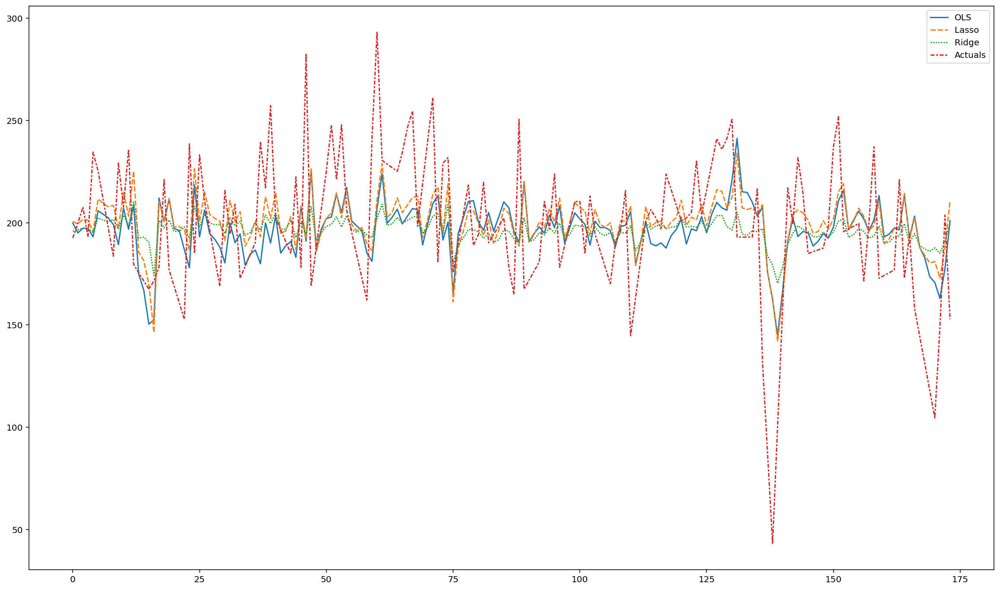

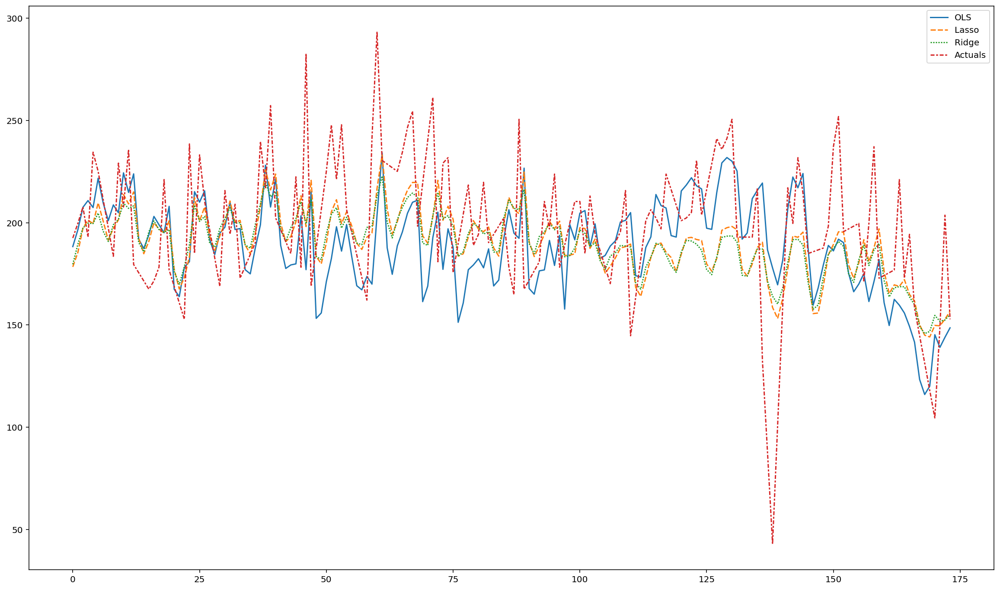

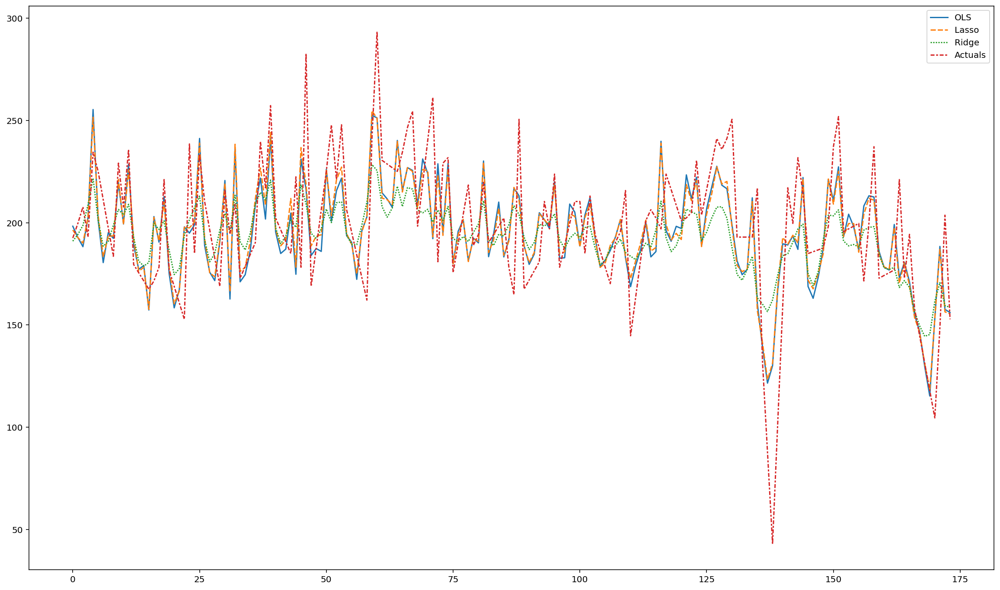

In [175]:
plt.figure(figsize=(20, 12))
sns.lineplot(data=all_results_nolags['Social']['predictions'])
plt.show()

plt.figure(figsize=(20, 12))
sns.lineplot(data=all_results_nolags['Search']['predictions'])
plt.show()

plt.figure(figsize=(20, 12))
sns.lineplot(data=all_results_onlylags['Search']['predictions'])
plt.show()

##### Explore Impression Lags On Model Performance

In [65]:
import numpy as np
import pandas as pd
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import TimeSeriesSplit
import matplotlib.pyplot as plt

def preprocess_train_lstm(dataset, target, n_steps=1, scale_data=True):
    data = dataset[[target]].values
    scaler = MinMaxScaler(feature_range=(0, 1))
    if scale_data:
        data = scaler.fit_transform(data)

    X, y = [], []
    for i in range(n_steps, len(data)):
        X.append(data[i-n_steps:i, 0])
        y.append(data[i, 0])
    
    X, y = np.array(X), np.array(y)
    X = X.reshape(X.shape[0], X.shape[1], 1) 

    tss = TimeSeriesSplit(n_splits=3)
    for train_index, test_index in tss.split(X):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]

    return X_train, y_train, X_test, y_test, scaler

def lstm_model(X_train, y_train, X_test, y_test, epochs=10, batch_size=1):
    model = Sequential([
        LSTM(64, activation='relu', input_shape=(X_train.shape[1], 1)),
        Dropout(0.2),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')

    model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=2)

    predictions = model.predict(X_test)
    return predictions

def run_lstm_pipeline(dataset, target):
    X_train, y_train, X_test, y_test, scaler = preprocess_train_lstm(dataset, target, n_steps=3)
    predictions = lstm_model(X_train, y_train, X_test, y_test)

    predictions = scaler.inverse_transform(predictions)
    actuals = scaler.inverse_transform(y_test.reshape(-1,1))

    print("R2 Score:", r2_score(actuals, predictions))
    plt.plot(actuals, label='Actual')
    plt.plot(predictions, label='Predicted')
    plt.legend()
    plt.show()

    return predictions



In [108]:


lstm_dataset = final_dataset[columns_3]
lstm_digital_dataset = digital_dataset[digital_colums]
lstm_claims_rba_encoded = claims_rba[columns_2]

In [67]:
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error, accuracy_score, mean_absolute_percentage_error


def evaluate_model(actuals, preds):
    mae = mean_absolute_error(actuals, preds)
    mse = mean_squared_error(actuals, preds)
    rmse = np.sqrt(mse)
    mape = mean_absolute_percentage_error(actuals, preds)
    r2 = r2_score(actuals, preds)
    
    return mae, mse, rmse, mape, r2
    #print(f"MAE: {mae}, MSE: {mse}, RMSE: {rmse}, MAPE: {mape}%, R2: {r2}")
    #plot_preds(actuals, preds)

## combined lstm

In [101]:
def loop_datasets(target, datasets):

    full_results = {}

    for name, dataset in datasets.items():  
        print(f"{name} Channel ", "\n")
        X_train, y_train, X_test, y_test, scaler = preprocess_train_lstm(dataset, target, n_steps=3)
        predictions = lstm_model(X_train, y_train, X_test, y_test, epochs=50, batch_size=1)

        predictions_rescaled = scaler.inverse_transform(predictions.reshape(-1,1))
        actuals_rescaled = scaler.inverse_transform(y_test.reshape(-1,1))

        mae, mse, rmse, mape, r2 = evaluate_model(actuals_rescaled, predictions_rescaled)
        lstm_preds = pd.DataFrame(data={"actuals": actuals_rescaled.ravel(), "preds": predictions_rescaled.ravel()})

        scores = {
            'mae': mae,
            'mse': mse,
            'rmse': rmse,
            'mape': mape,
            'r2': r2
        }

        model_stats = {
            'predictions': predictions_rescaled.tolist(),
            'scores': scores,
            'pred_actual': lstm_preds
        }
        
        
        print(f"\nMAE: {mae}, \nMSE: {mse}, \nRMSE: {rmse}, \nMAPE: {mape}%, \nR2: {r2}")

        plt.figure(figsize=(10, 6))
        plt.plot(actuals_rescaled, label='Actual Values')
        plt.plot(predictions_rescaled, label='Predicted Values')
        plt.title('Comparison of Actual and Predicted Values')
        plt.xlabel('Time')
        plt.ylabel('Value')
        plt.legend()
        plt.show()
        
        lstm_preds

        full_results[name] = model_stats
        
    return full_results

Social_lagsonly Channel  

Epoch 1/50
496/496 - 2s - loss: 0.0379 - 2s/epoch - 5ms/step
Epoch 2/50
496/496 - 1s - loss: 0.0159 - 1s/epoch - 2ms/step
Epoch 3/50
496/496 - 1s - loss: 0.0157 - 1s/epoch - 2ms/step
Epoch 4/50
496/496 - 1s - loss: 0.0157 - 1s/epoch - 2ms/step
Epoch 5/50
496/496 - 1s - loss: 0.0149 - 1s/epoch - 2ms/step
Epoch 6/50
496/496 - 1s - loss: 0.0137 - 1s/epoch - 2ms/step
Epoch 7/50
496/496 - 1s - loss: 0.0145 - 1s/epoch - 2ms/step
Epoch 8/50
496/496 - 1s - loss: 0.0137 - 1s/epoch - 3ms/step
Epoch 9/50
496/496 - 1s - loss: 0.0134 - 1s/epoch - 3ms/step
Epoch 10/50
496/496 - 1s - loss: 0.0123 - 1s/epoch - 3ms/step
Epoch 11/50
496/496 - 1s - loss: 0.0124 - 1s/epoch - 3ms/step
Epoch 12/50
496/496 - 1s - loss: 0.0126 - 1s/epoch - 3ms/step
Epoch 13/50
496/496 - 1s - loss: 0.0128 - 1s/epoch - 3ms/step
Epoch 14/50
496/496 - 1s - loss: 0.0124 - 1s/epoch - 3ms/step
Epoch 15/50
496/496 - 1s - loss: 0.0114 - 1s/epoch - 3ms/step
Epoch 16/50
496/496 - 1s - loss: 0.0115 - 1s/epoch -

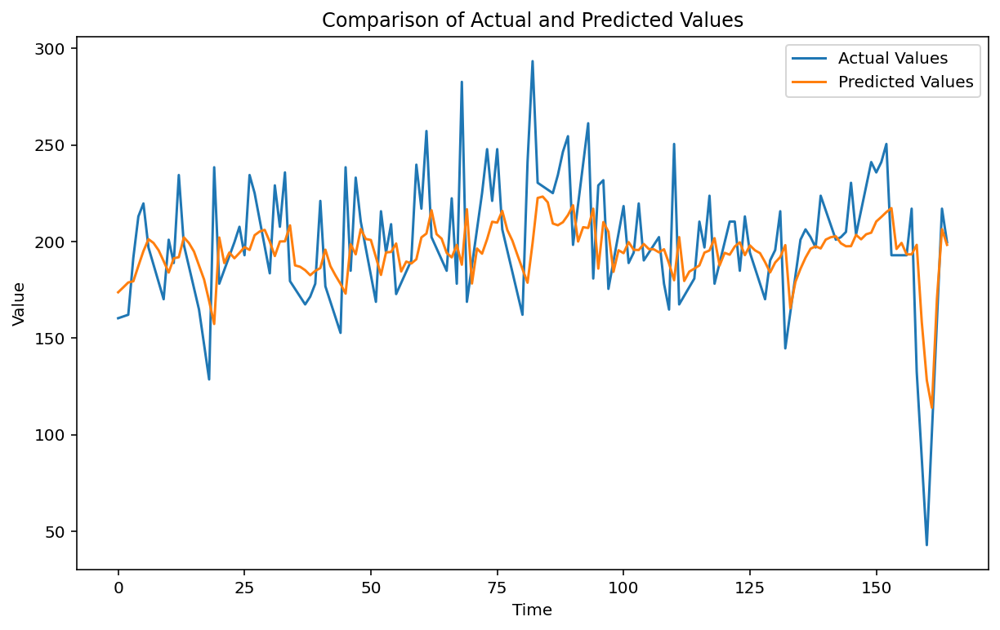

Social_lagsonly_min Channel  

Epoch 1/50
496/496 - 5s - loss: 0.0361 - 5s/epoch - 10ms/step
Epoch 2/50
496/496 - 1s - loss: 0.0150 - 1s/epoch - 3ms/step
Epoch 3/50
496/496 - 1s - loss: 0.0154 - 1s/epoch - 3ms/step
Epoch 4/50
496/496 - 1s - loss: 0.0145 - 1s/epoch - 3ms/step
Epoch 5/50
496/496 - 1s - loss: 0.0134 - 1s/epoch - 3ms/step
Epoch 6/50
496/496 - 1s - loss: 0.0132 - 1s/epoch - 3ms/step
Epoch 7/50
496/496 - 1s - loss: 0.0127 - 1s/epoch - 3ms/step
Epoch 8/50
496/496 - 1s - loss: 0.0130 - 1s/epoch - 3ms/step
Epoch 9/50
496/496 - 1s - loss: 0.0119 - 1s/epoch - 3ms/step
Epoch 10/50
496/496 - 1s - loss: 0.0123 - 1s/epoch - 3ms/step
Epoch 11/50
496/496 - 1s - loss: 0.0120 - 1s/epoch - 2ms/step
Epoch 12/50
496/496 - 1s - loss: 0.0120 - 1s/epoch - 2ms/step
Epoch 13/50
496/496 - 1s - loss: 0.0117 - 1s/epoch - 2ms/step
Epoch 14/50
496/496 - 1s - loss: 0.0114 - 1s/epoch - 2ms/step
Epoch 15/50
496/496 - 1s - loss: 0.0115 - 1s/epoch - 2ms/step
Epoch 16/50
496/496 - 1s - loss: 0.0111 - 1s/ep

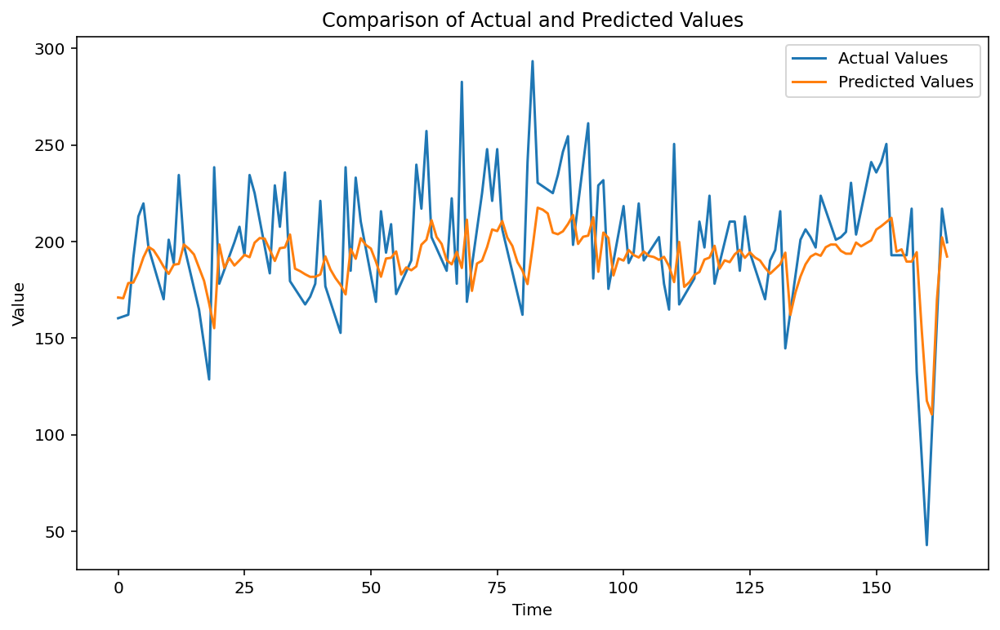

Social_no_lags Channel  

Epoch 1/50
496/496 - 2s - loss: 0.0346 - 2s/epoch - 4ms/step
Epoch 2/50
496/496 - 1s - loss: 0.0157 - 997ms/epoch - 2ms/step
Epoch 3/50
496/496 - 1s - loss: 0.0146 - 1s/epoch - 2ms/step
Epoch 4/50
496/496 - 1s - loss: 0.0141 - 1s/epoch - 2ms/step
Epoch 5/50
496/496 - 1s - loss: 0.0144 - 924ms/epoch - 2ms/step
Epoch 6/50
496/496 - 1s - loss: 0.0139 - 1s/epoch - 2ms/step
Epoch 7/50
496/496 - 1s - loss: 0.0140 - 940ms/epoch - 2ms/step
Epoch 8/50
496/496 - 1s - loss: 0.0129 - 1s/epoch - 2ms/step
Epoch 9/50
496/496 - 1s - loss: 0.0123 - 1s/epoch - 2ms/step
Epoch 10/50
496/496 - 1s - loss: 0.0122 - 1s/epoch - 2ms/step
Epoch 11/50
496/496 - 1s - loss: 0.0118 - 995ms/epoch - 2ms/step
Epoch 12/50
496/496 - 1s - loss: 0.0113 - 1s/epoch - 2ms/step
Epoch 13/50
496/496 - 1s - loss: 0.0114 - 1s/epoch - 2ms/step
Epoch 14/50
496/496 - 1s - loss: 0.0108 - 1s/epoch - 2ms/step
Epoch 15/50
496/496 - 1s - loss: 0.0109 - 1s/epoch - 2ms/step
Epoch 16/50
496/496 - 1s - loss: 0.0110 -

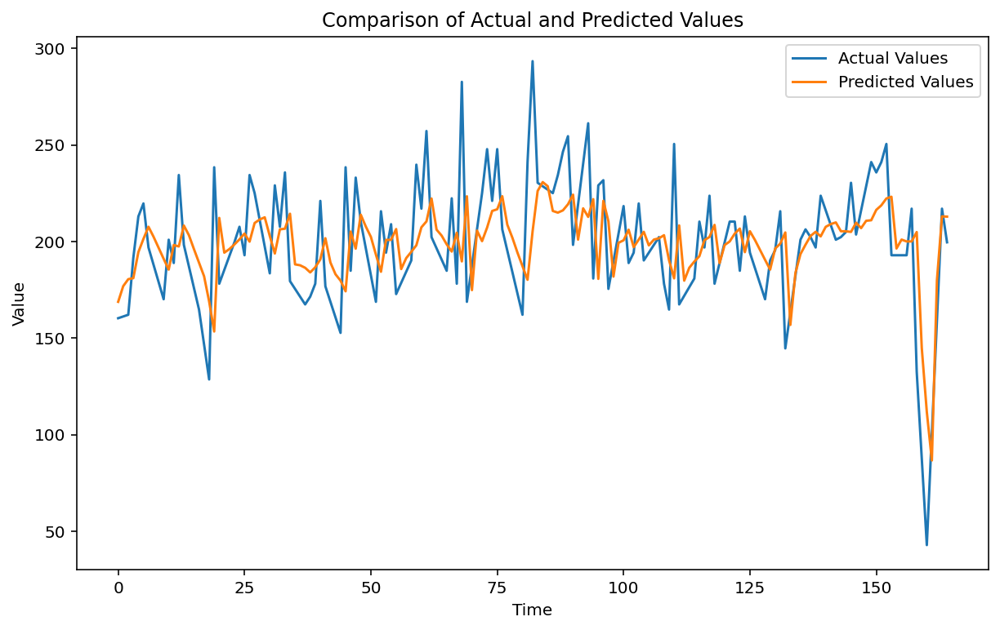

Search_lagsonly Channel  

Epoch 1/50
496/496 - 2s - loss: 0.0318 - 2s/epoch - 4ms/step
Epoch 2/50
496/496 - 1s - loss: 0.0149 - 846ms/epoch - 2ms/step
Epoch 3/50
496/496 - 1s - loss: 0.0148 - 842ms/epoch - 2ms/step
Epoch 4/50
496/496 - 1s - loss: 0.0144 - 954ms/epoch - 2ms/step
Epoch 5/50
496/496 - 1s - loss: 0.0139 - 954ms/epoch - 2ms/step
Epoch 6/50
496/496 - 1s - loss: 0.0142 - 874ms/epoch - 2ms/step
Epoch 7/50
496/496 - 1s - loss: 0.0133 - 903ms/epoch - 2ms/step
Epoch 8/50
496/496 - 1s - loss: 0.0130 - 928ms/epoch - 2ms/step
Epoch 9/50
496/496 - 1s - loss: 0.0130 - 1s/epoch - 2ms/step
Epoch 10/50
496/496 - 1s - loss: 0.0116 - 943ms/epoch - 2ms/step
Epoch 11/50
496/496 - 1s - loss: 0.0119 - 739ms/epoch - 1ms/step
Epoch 12/50
496/496 - 1s - loss: 0.0118 - 848ms/epoch - 2ms/step
Epoch 13/50
496/496 - 1s - loss: 0.0110 - 822ms/epoch - 2ms/step
Epoch 14/50
496/496 - 1s - loss: 0.0108 - 1s/epoch - 2ms/step
Epoch 15/50
496/496 - 1s - loss: 0.0113 - 1s/epoch - 3ms/step
Epoch 16/50
496/496

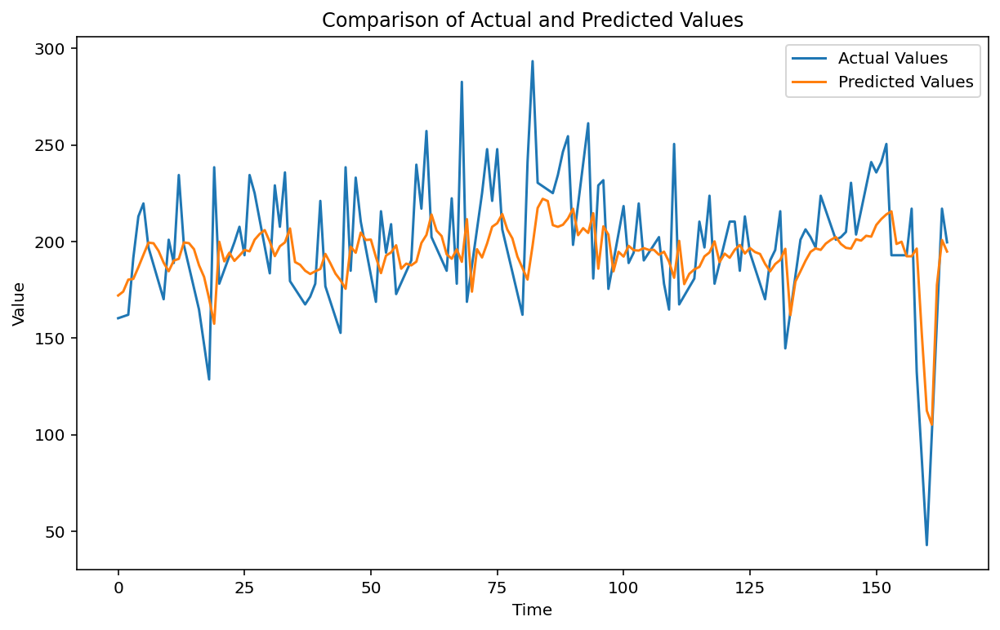

Search_lagsonly_min Channel  

Epoch 1/50
496/496 - 2s - loss: 0.0314 - 2s/epoch - 4ms/step
Epoch 2/50
496/496 - 1s - loss: 0.0158 - 1s/epoch - 2ms/step
Epoch 3/50
496/496 - 1s - loss: 0.0157 - 1s/epoch - 2ms/step
Epoch 4/50
496/496 - 1s - loss: 0.0140 - 1s/epoch - 2ms/step
Epoch 5/50
496/496 - 1s - loss: 0.0142 - 1s/epoch - 2ms/step
Epoch 6/50
496/496 - 1s - loss: 0.0122 - 1s/epoch - 2ms/step
Epoch 7/50
496/496 - 1s - loss: 0.0139 - 1s/epoch - 2ms/step
Epoch 8/50
496/496 - 1s - loss: 0.0131 - 1s/epoch - 2ms/step
Epoch 9/50
496/496 - 1s - loss: 0.0125 - 1s/epoch - 2ms/step
Epoch 10/50
496/496 - 1s - loss: 0.0116 - 812ms/epoch - 2ms/step
Epoch 11/50
496/496 - 1s - loss: 0.0120 - 940ms/epoch - 2ms/step
Epoch 12/50
496/496 - 1s - loss: 0.0114 - 943ms/epoch - 2ms/step
Epoch 13/50
496/496 - 1s - loss: 0.0113 - 897ms/epoch - 2ms/step
Epoch 14/50
496/496 - 1s - loss: 0.0113 - 924ms/epoch - 2ms/step
Epoch 15/50
496/496 - 1s - loss: 0.0111 - 996ms/epoch - 2ms/step
Epoch 16/50
496/496 - 1s - los

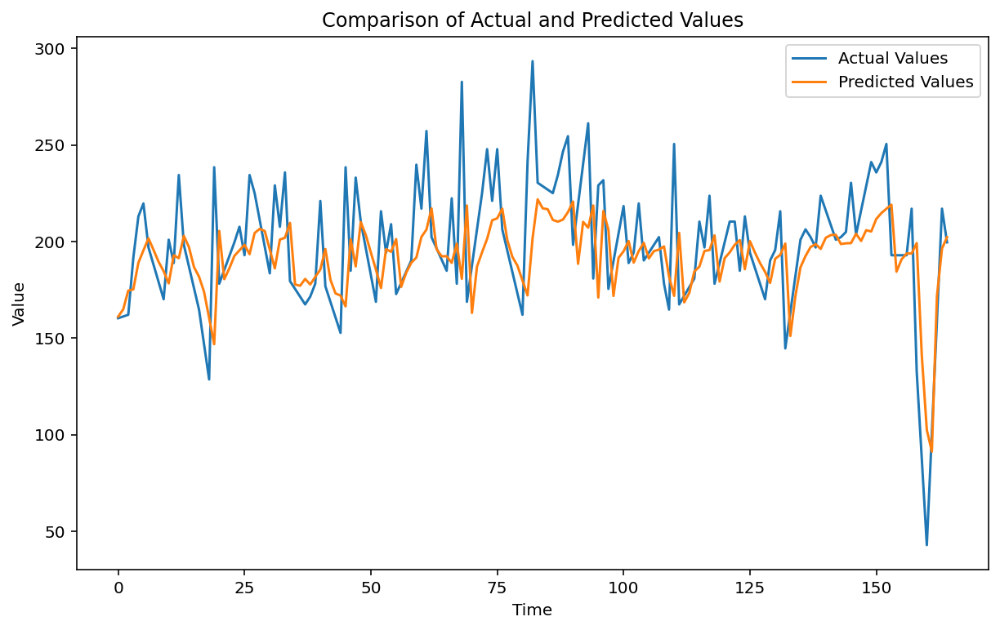

Search_no_lags Channel  

Epoch 1/50
496/496 - 2s - loss: 0.0269 - 2s/epoch - 4ms/step
Epoch 2/50
496/496 - 1s - loss: 0.0155 - 1s/epoch - 2ms/step
Epoch 3/50
496/496 - 1s - loss: 0.0136 - 944ms/epoch - 2ms/step
Epoch 4/50
496/496 - 1s - loss: 0.0142 - 987ms/epoch - 2ms/step
Epoch 5/50
496/496 - 1s - loss: 0.0131 - 825ms/epoch - 2ms/step
Epoch 6/50
496/496 - 1s - loss: 0.0131 - 1s/epoch - 2ms/step
Epoch 7/50
496/496 - 1s - loss: 0.0127 - 1s/epoch - 2ms/step
Epoch 8/50
496/496 - 1s - loss: 0.0128 - 1s/epoch - 2ms/step
Epoch 9/50
496/496 - 1s - loss: 0.0121 - 995ms/epoch - 2ms/step
Epoch 10/50
496/496 - 1s - loss: 0.0126 - 1s/epoch - 2ms/step
Epoch 11/50
496/496 - 1s - loss: 0.0117 - 1s/epoch - 2ms/step
Epoch 12/50
496/496 - 1s - loss: 0.0114 - 1s/epoch - 2ms/step
Epoch 13/50
496/496 - 1s - loss: 0.0113 - 1s/epoch - 2ms/step
Epoch 14/50
496/496 - 1s - loss: 0.0117 - 974ms/epoch - 2ms/step
Epoch 15/50
496/496 - 1s - loss: 0.0111 - 1s/epoch - 2ms/step
Epoch 16/50
496/496 - 1s - loss: 0.011

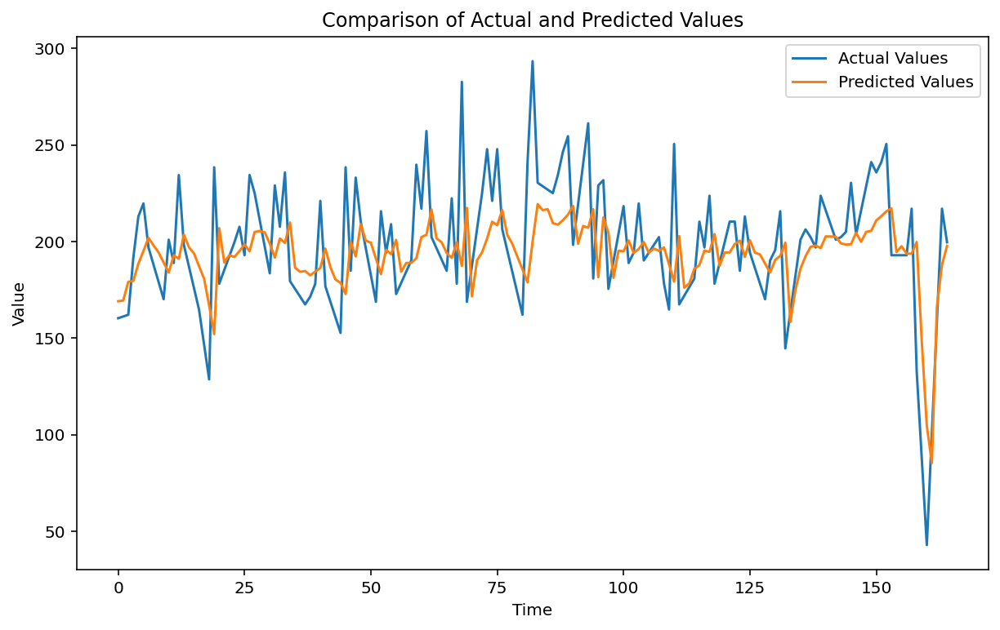

Digital_lagsonly Channel  

Epoch 1/50
496/496 - 2s - loss: 0.0451 - 2s/epoch - 4ms/step
Epoch 2/50
496/496 - 1s - loss: 0.0172 - 1s/epoch - 2ms/step
Epoch 3/50
496/496 - 1s - loss: 0.0160 - 1s/epoch - 2ms/step
Epoch 4/50
496/496 - 1s - loss: 0.0152 - 972ms/epoch - 2ms/step
Epoch 5/50
496/496 - 1s - loss: 0.0144 - 974ms/epoch - 2ms/step
Epoch 6/50
496/496 - 1s - loss: 0.0134 - 1s/epoch - 2ms/step
Epoch 7/50
496/496 - 1s - loss: 0.0132 - 1s/epoch - 2ms/step
Epoch 8/50
496/496 - 1s - loss: 0.0120 - 979ms/epoch - 2ms/step
Epoch 9/50
496/496 - 1s - loss: 0.0115 - 931ms/epoch - 2ms/step
Epoch 10/50
496/496 - 1s - loss: 0.0123 - 998ms/epoch - 2ms/step
Epoch 11/50
496/496 - 1s - loss: 0.0117 - 1s/epoch - 2ms/step
Epoch 12/50
496/496 - 1s - loss: 0.0104 - 1s/epoch - 2ms/step
Epoch 13/50
496/496 - 1s - loss: 0.0103 - 1s/epoch - 2ms/step
Epoch 14/50
496/496 - 1s - loss: 0.0109 - 1s/epoch - 2ms/step
Epoch 15/50
496/496 - 1s - loss: 0.0111 - 959ms/epoch - 2ms/step
Epoch 16/50
496/496 - 1s - loss: 

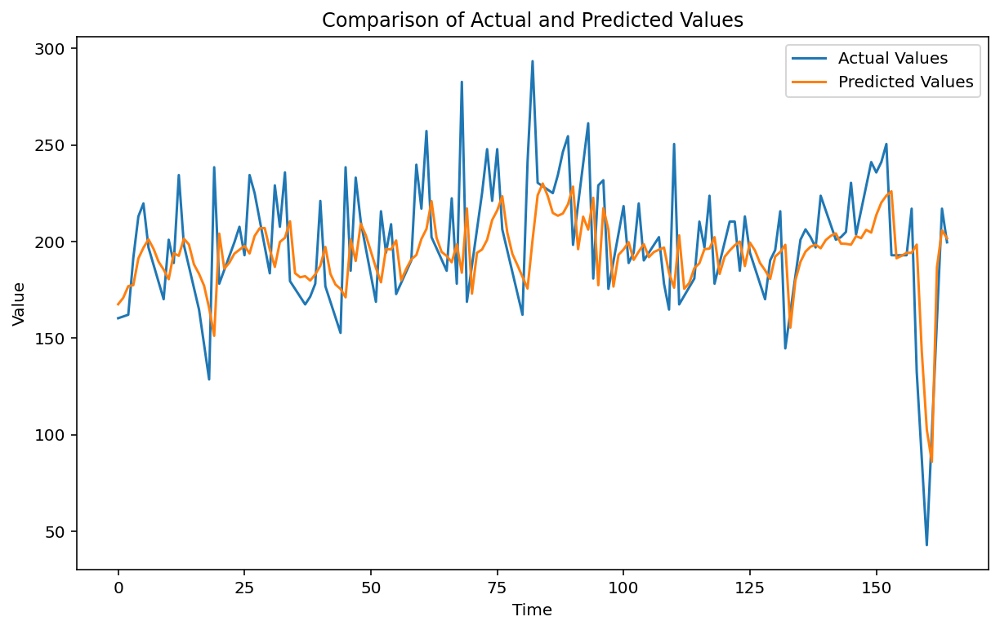

Digital_lagsonly_min Channel  

Epoch 1/50
496/496 - 2s - loss: 0.0334 - 2s/epoch - 4ms/step
Epoch 2/50
496/496 - 1s - loss: 0.0148 - 956ms/epoch - 2ms/step
Epoch 3/50
496/496 - 1s - loss: 0.0148 - 898ms/epoch - 2ms/step
Epoch 4/50
496/496 - 1s - loss: 0.0144 - 999ms/epoch - 2ms/step
Epoch 5/50
496/496 - 1s - loss: 0.0139 - 1s/epoch - 2ms/step
Epoch 6/50
496/496 - 1s - loss: 0.0131 - 1s/epoch - 2ms/step
Epoch 7/50
496/496 - 1s - loss: 0.0126 - 1s/epoch - 2ms/step
Epoch 8/50
496/496 - 1s - loss: 0.0121 - 1s/epoch - 2ms/step
Epoch 9/50
496/496 - 1s - loss: 0.0127 - 1s/epoch - 2ms/step
Epoch 10/50
496/496 - 1s - loss: 0.0120 - 1s/epoch - 2ms/step
Epoch 11/50
496/496 - 1s - loss: 0.0114 - 1s/epoch - 2ms/step
Epoch 12/50
496/496 - 1s - loss: 0.0114 - 901ms/epoch - 2ms/step
Epoch 13/50
496/496 - 1s - loss: 0.0108 - 1s/epoch - 2ms/step
Epoch 14/50
496/496 - 1s - loss: 0.0101 - 1s/epoch - 2ms/step
Epoch 15/50
496/496 - 1s - loss: 0.0102 - 1s/epoch - 2ms/step
Epoch 16/50
496/496 - 1s - loss: 0.

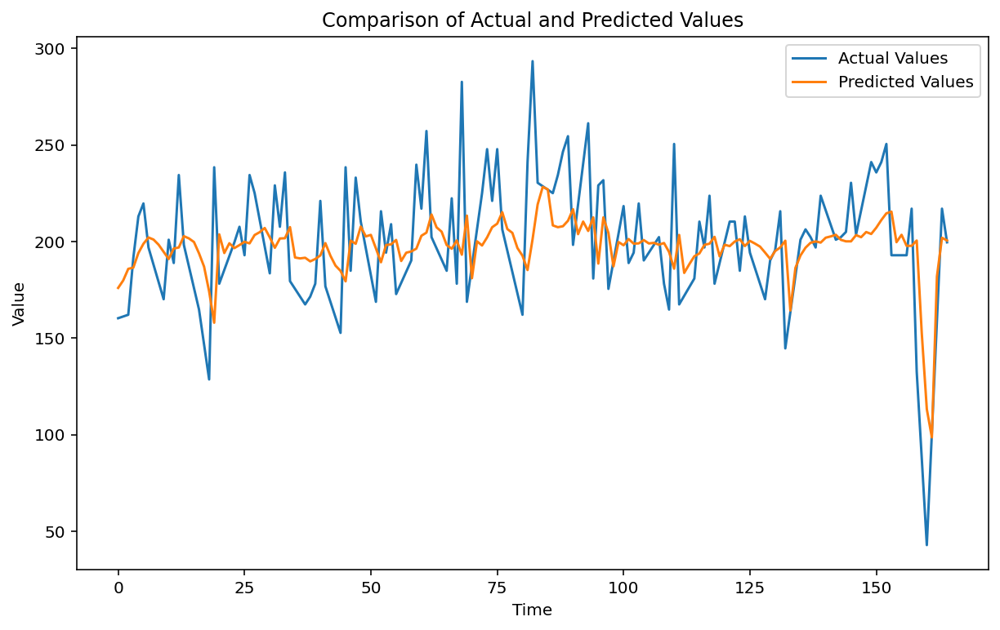

Digital_no_lags Channel  

Epoch 1/50
496/496 - 2s - loss: 0.0386 - 2s/epoch - 4ms/step
Epoch 2/50
496/496 - 1s - loss: 0.0165 - 1s/epoch - 3ms/step
Epoch 3/50
496/496 - 1s - loss: 0.0147 - 1s/epoch - 2ms/step
Epoch 4/50
496/496 - 1s - loss: 0.0148 - 1s/epoch - 2ms/step
Epoch 5/50
496/496 - 1s - loss: 0.0136 - 984ms/epoch - 2ms/step
Epoch 6/50
496/496 - 1s - loss: 0.0140 - 1s/epoch - 2ms/step
Epoch 7/50
496/496 - 1s - loss: 0.0143 - 1s/epoch - 2ms/step
Epoch 8/50
496/496 - 1s - loss: 0.0133 - 981ms/epoch - 2ms/step
Epoch 9/50
496/496 - 1s - loss: 0.0130 - 1s/epoch - 2ms/step
Epoch 10/50
496/496 - 1s - loss: 0.0126 - 963ms/epoch - 2ms/step
Epoch 11/50
496/496 - 1s - loss: 0.0133 - 1s/epoch - 2ms/step
Epoch 12/50
496/496 - 1s - loss: 0.0115 - 971ms/epoch - 2ms/step
Epoch 13/50
496/496 - 1s - loss: 0.0116 - 937ms/epoch - 2ms/step
Epoch 14/50
496/496 - 1s - loss: 0.0118 - 943ms/epoch - 2ms/step
Epoch 15/50
496/496 - 1s - loss: 0.0116 - 969ms/epoch - 2ms/step
Epoch 16/50
496/496 - 1s - loss

KeyboardInterrupt: 

In [102]:
channel_datasets = {
    
    'Social_lagsonly': redacted_social_lagsonly,
    'Social_lagsonly_min': redacted_social_lagsonly_min,
    'Social_no_lags': redacted_social_nolags,
    'Search_lagsonly': redacted_search_lagsonly,
    'Search_lagsonly_min': redacted_search_lagsonly_min,
    'Search_no_lags': redacted_search_nolags,
    'Digital_lagsonly': redacted_digital_lagsonly,
    'Digital_lagsonly_min': redacted_digital_lagsonly_min,
    'Digital_no_lags': redacted_digital_nolags,
    'Overall': redacted_overall,
    'Overall_no_lags': redacted_overall_nolags
}

target_column = 'redacted_rx'
all_results = loop_datasets(target_column, channel_datasets)

In [78]:
all_results.redacteds()

dict_keys(['Social_lagsonly', 'Social_lagsonly_min', 'Social_no_lags', 'Search_lagsonly', 'Search_lagsonly_min', 'Search_no_lags', 'Digital_lagsonly', 'Digital_lagsonly_min', 'Digital_no_lags', 'Overall', 'Overall_no_lags'])

In [79]:
all_results['Social_lagsonly'].redacteds()

dict_keys(['predictions', 'scores'])

In [100]:
0.107*100

10.7

In [99]:
for result, stats in all_results.items():
    print(result)
    print(round(stats['scores']['r2'], 3), round(stats['scores']['mape'], 3))
    

Social_lagsonly
0.292 0.107
Social_lagsonly_min
0.236 0.108
Social_no_lags
0.278 0.112
Search_lagsonly
0.242 0.11
Search_lagsonly_min
0.305 0.107
Search_no_lags
0.25 0.113
Digital_lagsonly
0.289 0.107
Digital_lagsonly_min
0.291 0.115
Digital_no_lags
0.313 0.108
Overall
0.263 0.113
Overall_no_lags
0.274 0.11


Epoch 1/50
543/543 - 3s - loss: 0.0274 - 3s/epoch - 6ms/step
Epoch 2/50
543/543 - 2s - loss: 0.0142 - 2s/epoch - 3ms/step
Epoch 3/50
543/543 - 2s - loss: 0.0130 - 2s/epoch - 3ms/step
Epoch 4/50
543/543 - 2s - loss: 0.0118 - 2s/epoch - 3ms/step
Epoch 5/50
543/543 - 2s - loss: 0.0122 - 2s/epoch - 3ms/step
Epoch 6/50
543/543 - 2s - loss: 0.0116 - 2s/epoch - 3ms/step
Epoch 7/50
543/543 - 2s - loss: 0.0111 - 2s/epoch - 3ms/step
Epoch 8/50
543/543 - 2s - loss: 0.0111 - 2s/epoch - 3ms/step
Epoch 9/50
543/543 - 2s - loss: 0.0100 - 2s/epoch - 3ms/step
Epoch 10/50
543/543 - 2s - loss: 0.0099 - 2s/epoch - 3ms/step
Epoch 11/50
543/543 - 2s - loss: 0.0097 - 2s/epoch - 3ms/step
Epoch 12/50
543/543 - 2s - loss: 0.0098 - 2s/epoch - 3ms/step
Epoch 13/50
543/543 - 2s - loss: 0.0098 - 2s/epoch - 3ms/step
Epoch 14/50
543/543 - 2s - loss: 0.0093 - 2s/epoch - 3ms/step
Epoch 15/50
543/543 - 2s - loss: 0.0087 - 2s/epoch - 3ms/step
Epoch 16/50
543/543 - 2s - loss: 0.0092 - 2s/epoch - 3ms/step
Epoch 17/50
543/5

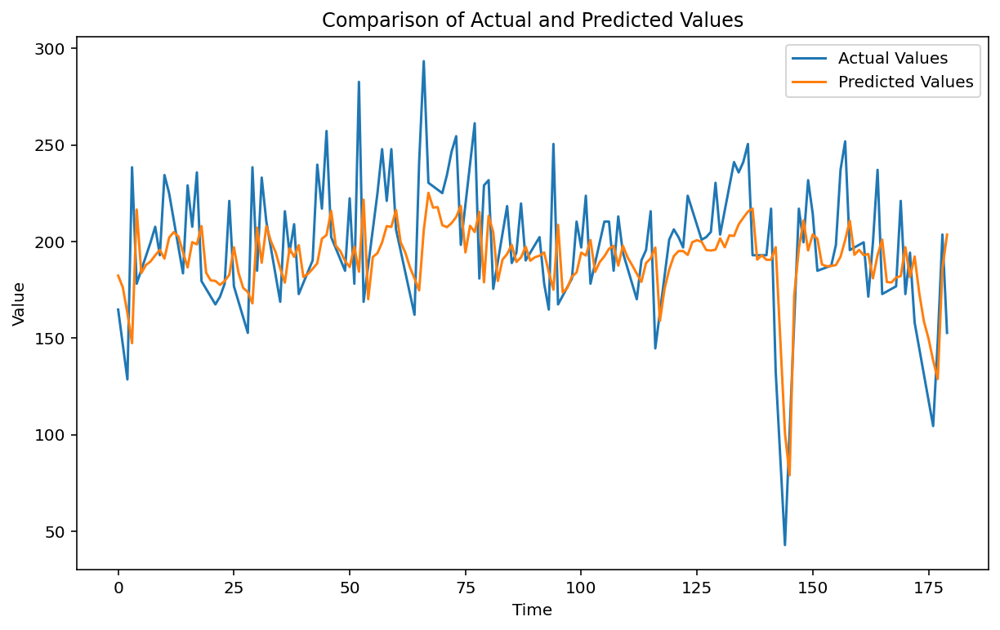

In [110]:
target_column = 'redacted_rx'  
X_train, y_train, X_test, y_test, scaler = preprocess_train_lstm(lstm_claims_rba_encoded, target_column, n_steps=3)
predictions = lstm_model(X_train, y_train, X_test, y_test, epochs=50, batch_size=1)

predictions_rescaled = scaler.inverse_transform(predictions.reshape(-1,1))
actuals_rescaled = scaler.inverse_transform(y_test.reshape(-1,1))

plt.figure(figsize=(10, 6))
plt.plot(actuals_rescaled, label='Actual Values')
plt.plot(predictions_rescaled, label='Predicted Values')
plt.title('Comparison of Actual and Predicted Values')
plt.xlabel('Time')
plt.ylabel('Value')
plt.legend()
plt.show()

MAE: 21.390470115944193, MSE: 810.4363239794696, RMSE: 28.468163340466305, MAPE: 0.11500306697121575%, R2: 0.2872921986318644


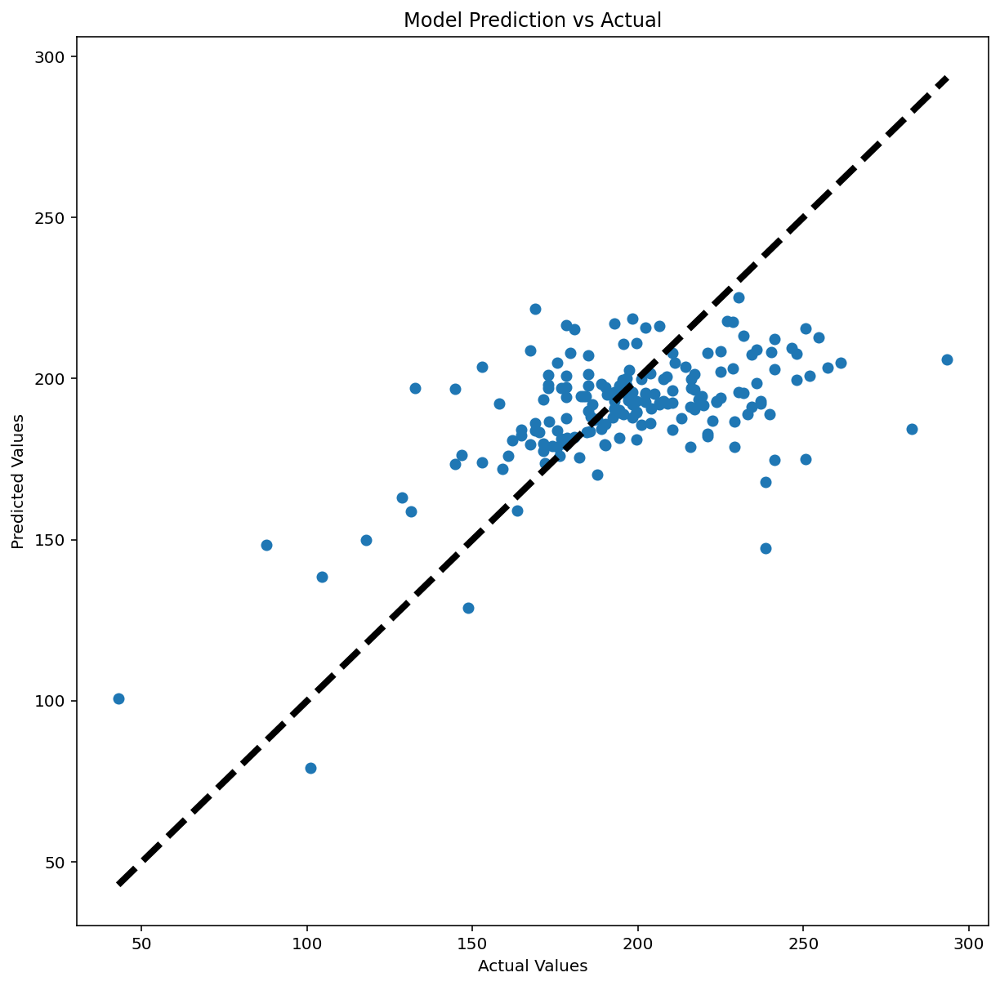

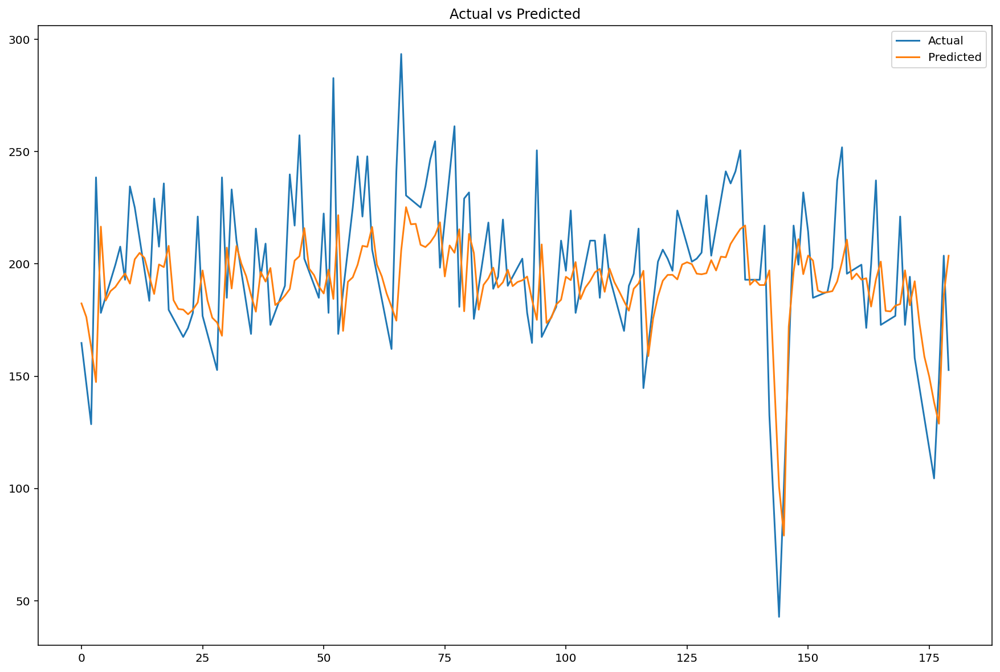

In [111]:
evaluate_model(actuals_rescaled, predictions_rescaled)

In [112]:
lstm_preds = pd.DataFrame(data={"actuals": actuals_rescaled.ravel(), "preds": predictions_rescaled.ravel()})
lstm_preds.head(30)

,actuals,preds
0,164.820000,182.412003
1,146.730000,176.384354
2,128.640000,162.985077
3,238.520000,147.419189
4,178.220000,216.612122
5,185.366667,183.716690
6,192.513333,187.901657
7,199.660000,189.751663
8,207.700000,192.900330
9,192.960000,195.742203


## digital lstm

Epoch 1/50
543/543 - 1s - loss: 0.0261 - 1s/epoch - 2ms/step
Epoch 2/50
543/543 - 1s - loss: 0.0139 - 548ms/epoch - 1ms/step
Epoch 3/50
543/543 - 1s - loss: 0.0133 - 540ms/epoch - 995us/step
Epoch 4/50
543/543 - 1s - loss: 0.0132 - 540ms/epoch - 994us/step
Epoch 5/50
543/543 - 1s - loss: 0.0122 - 542ms/epoch - 999us/step
Epoch 6/50
543/543 - 1s - loss: 0.0114 - 542ms/epoch - 998us/step
Epoch 7/50
543/543 - 1s - loss: 0.0118 - 542ms/epoch - 998us/step
Epoch 8/50
543/543 - 1s - loss: 0.0115 - 538ms/epoch - 991us/step
Epoch 9/50
543/543 - 1s - loss: 0.0113 - 526ms/epoch - 969us/step
Epoch 10/50
543/543 - 1s - loss: 0.0110 - 599ms/epoch - 1ms/step
Epoch 11/50
543/543 - 1s - loss: 0.0111 - 564ms/epoch - 1ms/step
Epoch 12/50
543/543 - 1s - loss: 0.0109 - 572ms/epoch - 1ms/step
Epoch 13/50
543/543 - 1s - loss: 0.0108 - 555ms/epoch - 1ms/step
Epoch 14/50
543/543 - 1s - loss: 0.0105 - 536ms/epoch - 988us/step
Epoch 15/50
543/543 - 1s - loss: 0.0106 - 544ms/epoch - 1ms/step
Epoch 16/50
543/543 -

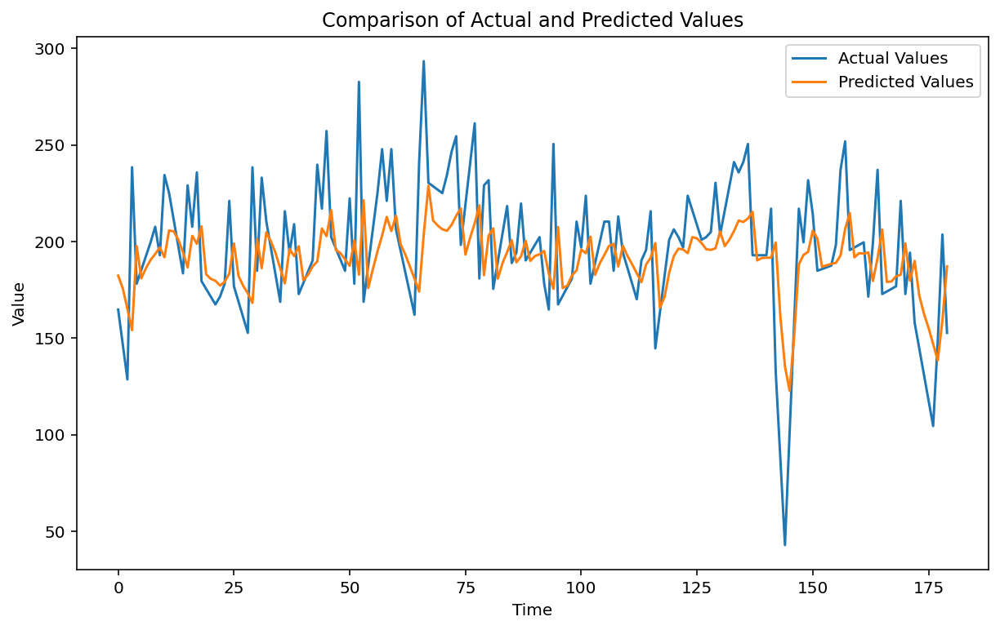

MAE: 21.75155542557328, MSE: 853.1403971842171, RMSE: 29.2085671881422, MAPE: 0.12092125168882899%, R2: 0.24973770456159294


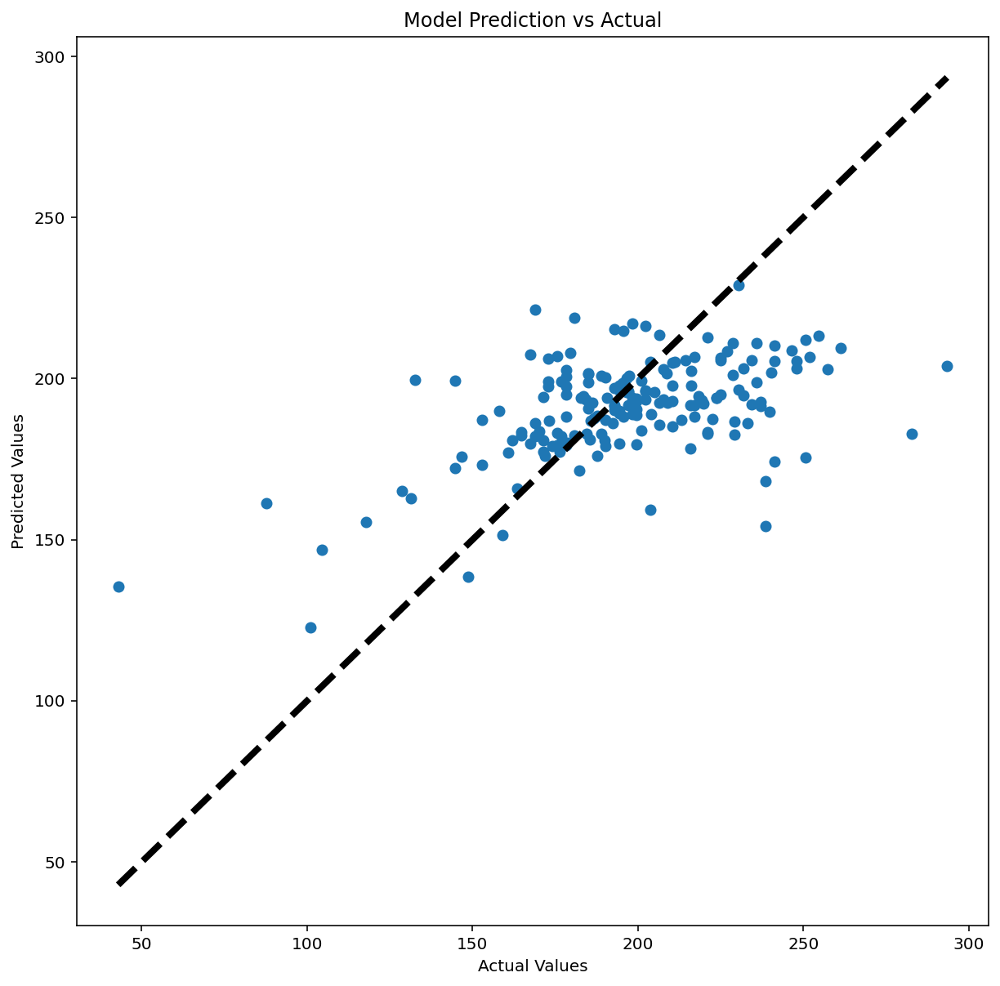

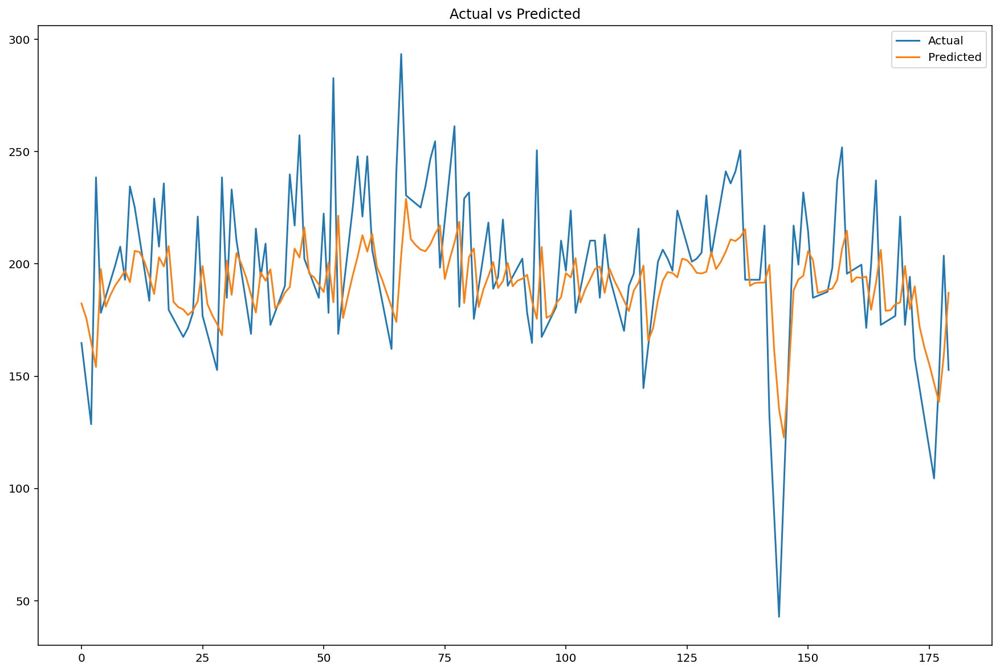

In [72]:

target_column = 'redacted_rx'  
X_train, y_train, X_test, y_test, scaler = preprocess_train_lstm(lstm_digital_dataset, target_column, n_steps=3)
predictions = lstm_model(X_train, y_train, X_test, y_test, epochs=50, batch_size=1)

predictions_rescaled = scaler.inverse_transform(predictions.reshape(-1,1))
actuals_rescaled = scaler.inverse_transform(y_test.reshape(-1,1))

plt.figure(figsize=(10, 6))
plt.plot(actuals_rescaled, label='Actual Values')
plt.plot(predictions_rescaled, label='Predicted Values')
plt.title('Comparison of Actual and Predicted Values')
plt.xlabel('Time')
plt.ylabel('Value')
plt.legend()
plt.show()

evaluate_model(actuals_rescaled, predictions_rescaled)

In [87]:
actuals_rescaled.ravel()

array([164.82      , 146.73      , 128.64      , 238.52      ,
       178.22      , 185.36666667, 192.51333333, 199.66      ,
       207.7       , 192.96      , 234.5       , 225.12      ,
       211.27333333, 197.42666667, 183.58      , 229.14      ,
       207.7       , 235.84      , 179.56      , 175.54      ,
       171.52      , 167.5       , 171.52      , 178.22      ,
       221.1       , 176.88      , 168.84      , 160.8       ,
       152.76      , 238.52      , 184.92      , 233.16      ,
       210.38      , 196.53333333, 182.68666667, 168.84      ,
       215.74      , 194.3       , 209.04      , 172.86      ,
       178.66666667, 184.47333333, 190.28      , 239.86      ,
       217.08      , 257.28      , 202.34      , 196.53333333,
       190.72666667, 184.92      , 222.44      , 178.22      ,
       282.74      , 168.84      , 187.6       , 206.36      ,
       225.12      , 247.9       , 221.1       , 247.9       ,
       206.36      , 195.305     , 184.25      , 173.19

In [89]:
lstm_preds = pd.DataFrame(data={"actuals": actuals_rescaled.ravel(), "preds": predictions_rescaled.ravel()})
lstm_preds.head(30)

,actuals,preds
0,164.820000,182.401474
1,146.730000,175.807114
2,128.640000,165.126175
3,238.520000,154.127670
4,178.220000,197.674286
5,185.366667,180.976898
6,192.513333,186.279755
7,199.660000,190.520508
8,207.700000,193.603165
9,192.960000,196.980667


MAE: 20.80449757554796, MSE: 779.6729199165699, RMSE: 27.922623800720626, MAPE: 0.11610489840218823%, R2: 0.31434591947770385


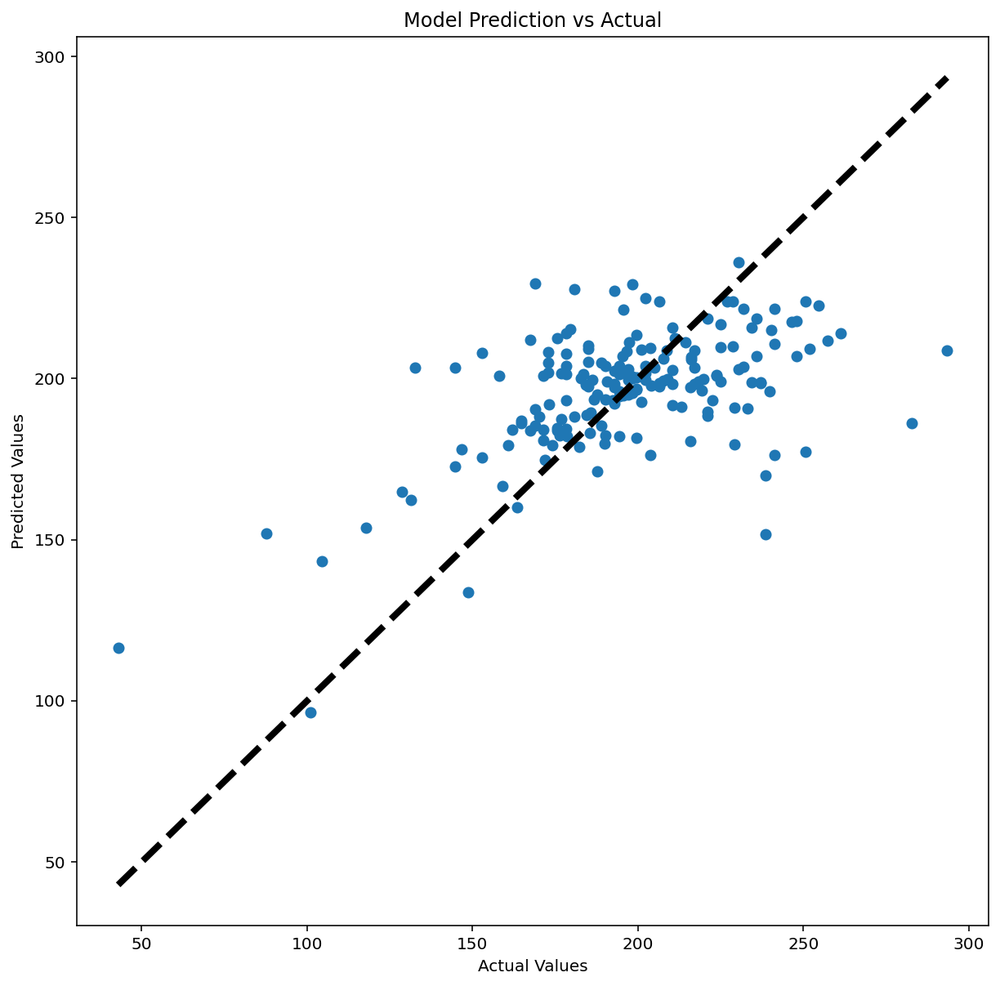

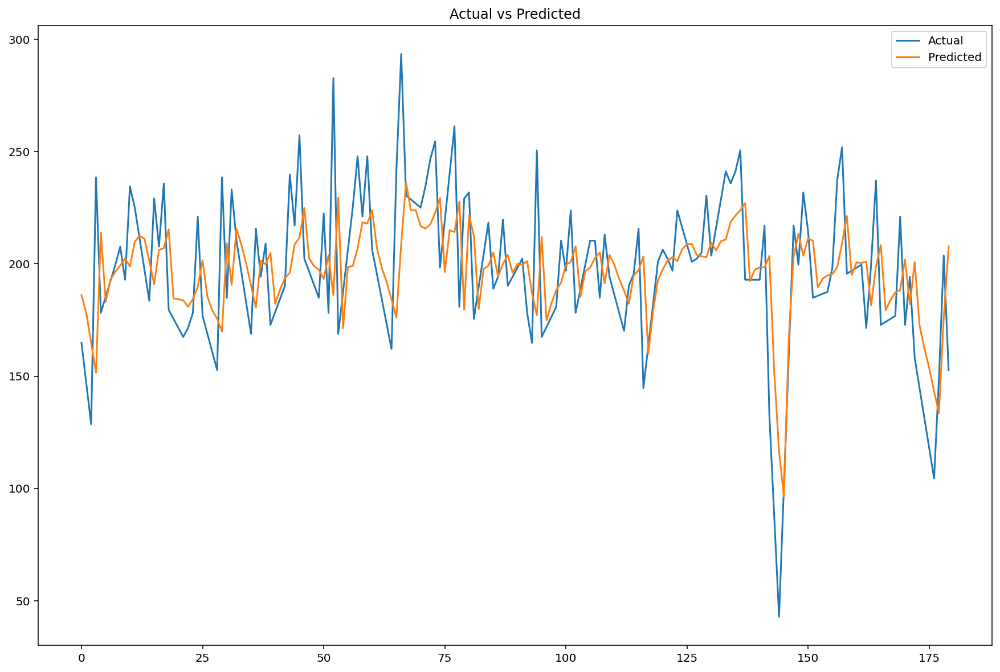

In [71]:
evaluate_model(actuals_rescaled, predictions_rescaled)